In [3]:
# Instalar librerías necesarias (ejecutar solo si es necesario)
#!pip install funpymodeling
#!pip install pandas numpy matplotlib seaborn
#!pip install plotly

# Librerias de análisis geografico
#!pip install geopandas
#!pip install shapely
#!pip install descartes
#!pip install pyproj
#!pip install contextily

### 1. Carga de datos

In [1]:

# Estas son las librerias que necsitamos para poder trabajar el dataset

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import plotly.express as px
import re
from matplotlib import pyplot as plt
import geopandas as gpd

#import shapely # genera las figuras geometricas
#import descartes # relaciona shapely con matplotlib
#import pyproj # proyecciones. Transformar coordenadas

#import contextily as ctx
from matplotlib.ticker import PercentFormatter

In [2]:
#cargo el csv
df = pd.read_csv('/Users/Usuario/Desktop/DATOS VIVOS/TP FINAL/dataset/properati.csv')
#df = pd.read_csv('/home/memonserrat/DATOS VIVOS/properati.csv')
df.head()

,id,ad_type,start_date,end_date,created_on,lat,lon,l1,l2,l3,...,bathrooms,surface_total,surface_covered,currency,price_period,title,description,property_type,operation_type,price
0,556713,Propiedad,2019-11-29,9999-12-31,2019-11-29,-58.442399,-34.573623,Argentina,Capital Federal,Colegiales,...,2.0,NaN,NaN,USD,NaN,"Departamento en Venta en Belgrano, Capital fed...","Sup total por escritura: 96,47 m2 (cubiertos: ...",Departamento,Venta,259000.0
1,192912,Propiedad,2020-06-05,2020-06-08,2020-06-05,-58.430493,-34.606620,Argentina,Capital Federal,Almagro,...,2.0,77.0,67.0,USD,NaN,Departamento de 3 ambientes en Venta en Almagro,Excelente departamento de tres ambientes ampli...,Departamento,Venta,235500.0
2,238224,Propiedad,2020-07-01,9999-12-31,2020-07-01,-58.491760,-34.574123,Argentina,Capital Federal,Villa Urquiza,...,1.0,60.0,55.0,USD,NaN,Andonaegui 2600 4° - - Departamento en Venta,Excelente 3 ambientes al frente con balcón. Vi...,Departamento,Venta,175000.0
3,257134,Propiedad,2019-08-17,9999-12-31,2019-08-17,-58.420737,-34.631770,Argentina,Capital Federal,Boedo,...,1.0,74.0,47.0,USD,NaN,PH Venta Boedo 2 amb Patio,Corredor Responsable: MARCELO TRUJILLO - CPI ...,PH,Venta,140000.0
4,521738,Propiedad,2019-08-05,2019-08-31,2019-08-05,-58.429983,-34.607225,Argentina,Capital Federal,Almagro,...,1.0,66.0,64.0,USD,NaN,Venta 3 Ambientes - Almagro - Balcón - Ameniti...,Corredor Responsable: Marcelo Trujillo - CUCIC...,Departamento,Venta,173000.0


### 2.  **Filtrar** las propiedades

según los siguientes criterios
    *   `country_name = "Argentina"`
    *   `operation_type = "Venta"`
    *   `currency = "USD"`
    *    zonas Capital Federal y Gran Bs. As.

In [3]:
#Veo que tipo de datos tienen las variables
# Análisis exploratorio básico
print("=== INFORMACIÓN BÁSICA DEL DATASET ===")
print(f"Total de registros: {len(df)}")
print(df.dtypes)


=== INFORMACIÓN BÁSICA DEL DATASET ===
Total de registros: 992192
id                   int64
ad_type             object
start_date          object
end_date            object
created_on          object
lat                float64
lon                float64
l1                  object
l2                  object
l3                  object
l4                  object
l5                  object
l6                 float64
rooms              float64
bedrooms           float64
bathrooms          float64
surface_total      float64
surface_covered    float64
currency            object
price_period        object
title               object
description         object
property_type       object
operation_type      object
price              float64
dtype: object


In [4]:
print("\n=== ESTADÍSTICAS DESCRIPTIVAS ===")
print(df.describe())


=== ESTADÍSTICAS DESCRIPTIVAS ===
                   id            lat            lon   l6          rooms  \
count   992192.000000  838994.000000  839929.000000  0.0  503045.000000   
mean    500338.438758     -59.266586     -34.793745  NaN       2.858577   
std     288685.497758       2.707383       3.066257  NaN       1.682454   
min          1.000000    -180.000000     -54.842464  NaN       1.000000   
25%     250259.750000     -58.756011     -34.921709  NaN       2.000000   
50%     500641.500000     -58.444383     -34.610508  NaN       3.000000   
75%     750507.250000     -58.058983     -34.459156  NaN       4.000000   
max    1000000.000000     -35.045025      85.051129  NaN      40.000000   

            bedrooms      bathrooms  surface_total  surface_covered  \
count  390699.000000  773021.000000   448164.00000     4.369610e+05   
mean        2.086094       1.697637      493.51136     5.769533e+02   
std         2.705342       1.072722     4101.38179     7.383998e+04   
min  

In [5]:
#veo que valores toma la variable l1
df['l1'].unique()


array(['Argentina', 'Uruguay', 'Estados Unidos', 'Brasil'], dtype=object)

In [6]:
df['l2'].unique()

array(['Capital Federal', 'Bs.As. G.B.A. Zona Sur',
       'Buenos Aires Interior', 'Córdoba', 'Bs.As. G.B.A. Zona Norte',
       'Santa Fe', 'Tucumán', 'Buenos Aires Costa Atlántica', 'Maldonado',
       'San Luis', 'Neuquén', 'Bs.As. G.B.A. Zona Oeste', 'Entre Ríos',
       'Montevideo', 'Mendoza', 'Misiones', 'Río Negro',
       'Tierra Del Fuego', 'Pennsylvania', 'Chubut', 'Corrientes',
       'Salta', 'La Rioja', 'La Pampa', 'Chaco', 'San Juan', 'Rocha',
       'Jujuy', 'Maryland', 'Canelones', 'Santa Catarina', 'Colonia',
       'Florida', 'Santa Cruz', 'Michigan', 'Miami',
       'Santiago Del Estero', 'Rio de Janeiro', 'Formosa', 'Catamarca',
       'Rio Grande do Norte', 'São Paulo'], dtype=object)

In [7]:
#veo que es la variable l3
valores_unicos = df['l3'].drop_duplicates()
print(valores_unicos)

0                         Colegiales
1                            Almagro
2                      Villa Urquiza
3                              Boedo
6                          San Telmo
                     ...            
976044                     Egusquiza
976059                   Mojones Sur
976099    Santa Clara de Buena Vista
978660                  Bella Italia
981498        Saladero Mariano Cabal
Name: l3, Length: 1263, dtype: object


In [8]:
#veo que es la variable l4
valores_unicos = df['l4'].drop_duplicates()
print(valores_unicos)

0                                  NaN
26                       Palermo Viejo
30                         Villa Elisa
45                            La Plata
47                   Palermo Hollywood
                      ...             
955480                 Tres Algarrobos
959146               Barrio 2 de Abril
959152                     Triunvirato
975951              Barrio San Eduardo
981564    Barrio Cerrado "Pilar House"
Name: l4, Length: 977, dtype: object


In [9]:
#veo que es la variable l5
valores_unicos = df['l5'].drop_duplicates()
print(valores_unicos)

0                                 NaN
5928                  Islas del Canal
6089                   Barrio El Golf
6219                 Barrio Los Lagos
6224                Barrio Los Sauces
6374                  Barrio El Yacht
6428                 BarrioPortezuelo
6431                 Barrio Los Tilos
6672          Barrio Lagos del Golf 2
6687            Barrio Cabos del Lago
7884             Barrio Las Glorietas
8218                Barrio Los Alisos
8603               Barrio Las Caletas
10286       Barrio Barrancas del Lago
10498             Barrio Los Castores
11121    Barrio Residencial Pacheco 2
16431                           Enyoi
18753         Barrio Lagos del Golf 1
25642                  Barrio La Isla
37577               Barrio La Alameda
43023                      QBay Yacht
80221    Barrio Residencial Pacheco 1
Name: l5, dtype: object


In [10]:
#veo que es la variable l6
valores_unicos = df['l6'].drop_duplicates()
print(valores_unicos)

0   NaN
Name: l6, dtype: float64


In [11]:
#veo que valores tienen las variables operation_type y currency
valores_unicos = df['operation_type'].drop_duplicates()
valores_currency = df['currency'].drop_duplicates()

print(valores_unicos)
print(valores_currency)


0                   Venta
5653             Alquiler
5659    Alquiler temporal
Name: operation_type, dtype: object
0        USD
5653     ARS
5694     NaN
7463     UYU
18529    PEN
Name: currency, dtype: object


In [12]:
#Renombro variables l1 y l2
df = df.rename(columns= {'l1': 'country_name'})
df = df.rename(columns= {'l2': 'state_name'})
df = df.rename(columns= {'l3': 'place_name'})


In [13]:
#Aplico los filtros que recomiendan en el ejercicio
import pandas as pd

# Filtro de país, tipo de operación y moneda
filtro_base = (
    (df['country_name'] == 'Argentina') &
    (df['operation_type'] == 'Venta') &
    (df['currency'] == 'USD')
)

# Filtro de zonas (ejemplo: columna 'zone_name')
zonas = ['Capital Federal', 'Bs.As. G.B.A. Zona Sur','Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste']
filtro_zonas = df['state_name'].isin(zonas)

# Aplicamos el filtro combinado
df_filtrado = df[filtro_base & filtro_zonas]

# Verificamos el resultado
print(df_filtrado.shape)
df_filtrado.head()
df2=df_filtrado.copy()

(394641, 25)


### Analisis de la base

In [14]:
# Verificamos el tamaño del dataset
print("\n===Resumen de primer análisis del dataset===")
print(f"Número de filas: {df2.shape[0]}")
print(f"Número de columnas: {df2.shape[1]}")
print(f"Hay {df2.duplicated().sum()} filas duplicadas")
#print(f"{df2.isna().sum()}")


===Resumen de primer análisis del dataset===
Número de filas: 394641
Número de columnas: 25
Hay 0 filas duplicadas


In [15]:
#Veo los NAN que tiene cada variable y su porcentaje
from funpymodeling.exploratory import status
print(f"En que columnas hay nulos?")
status(df2)

En que columnas hay nulos?


,variable,q_nan,p_nan,q_zeros,p_zeros,unique,type
0,id,0,0.000000,0,0.000000,394641,int64
1,ad_type,0,0.000000,0,0.000000,1,object
2,start_date,0,0.000000,0,0.000000,346,object
3,end_date,0,0.000000,0,0.000000,448,object
4,created_on,0,0.000000,0,0.000000,346,object
5,lat,63164,0.160054,0,0.000000,137100,float64
6,lon,62718,0.158924,0,0.000000,136792,float64
7,country_name,0,0.000000,0,0.000000,1,object
8,state_name,0,0.000000,0,0.000000,4,object
9,place_name,21401,0.054229,0,0.000000,90,object


In [16]:
df2['state_name'].unique()

array(['Capital Federal', 'Bs.As. G.B.A. Zona Sur',
       'Bs.As. G.B.A. Zona Norte', 'Bs.As. G.B.A. Zona Oeste'],
      dtype=object)

In [17]:
df2['ad_type'].unique()

array(['Propiedad'], dtype=object)

In [18]:
df2['title'].unique()

array(['Departamento en Venta en Belgrano, Capital federal ',
       'Departamento de 3 ambientes en Venta en Almagro',
       'Andonaegui   2600 4°  -  - Departamento en Venta', ...,
       'Barbaro Vende casa 6 ambientes en San Martin',
       'GRAN CASA EN FLORIDA OESTE 4 AMBIENTES',
       'GRAN CASA EN IMPORTANTE LOTE Y EXCELENTE UBICACIÓN !'],
      dtype=object)

In [19]:
df2['description'].unique()

array(['Sup total por escritura: 96,47 m2 (cubiertos: 61 m2 y descubiertos: 35,79 m2).&nbsp;\nActualmente cuenta en el 9no piso con un cerramiento de 14 m2 aprox ganados sobre los metros descubiertos del balcón.\n\nHermoso 4 ambientes tipo Duplex \n\na 2 cuadras de Avda Cabildo, \n\ncon variedad de medios de transporte\n\n(Metrobus- subte línea D). \n\nVENTA DIRECTA, el propietario no necesita otra propiedad. \n\n(el ascensor llega hasta el 7° piso, el acceso a la propiedad es de un piso por escalera)\n\nSemipiso súper luminoso desarrollado en 2 plantas:\n\n8vo piso:\n\nLiving comedor con pisos flotantes. \n\nBalcón terraza con excelente vista abierta.\n\nAmplia cocina office.\n\nBaulera en bajo escalera. \n\n9no piso:\n\nDormitorio principal en suite. \n\n2do dormitorio con acceso a balcón con cerramiento parcial. \n\nToilette.\n\nBaulera.\n\nLe interesa comprar esta propiedad y no vendió la suya? Llámenos al 4777-5000 y lo ayudaremos\n\nMás info y video clickee aquí \n\nhttp://www.ca

In [20]:
#Elimino L4, L5 , L6 y price_period que tienen más del 50% de NAN
#df2.drop(columns = ['l4', 'l5','l6','price_period'], inplace = True, axis=0)
#Elimino las variables 'country_name''operation_type' 'currency' porque como son las que filtre se que tienen un unico valor
#df2.drop(columns = ['country_name', 'operation_type', 'currency'], inplace = True, axis=0)
#Elimino las variables que tienen un unico valor
#df2.drop(columns = ['ad_type'], inplace = True, axis=0)
#Elimino las variables title y description que son de la publicación
#df2.drop(columns = ['title','description'], inplace = True, axis=0)

In [21]:
# Verificamos el tamaño del dataset
print("\n===Resumen de primer análisis del dataset===")
print(f"Número de filas: {df2.shape[0]}")
print(f"Número de columnas: {df2.shape[1]}")
#df3.head(5)



===Resumen de primer análisis del dataset===
Número de filas: 394641
Número de columnas: 25


## 3.  **Explorar variables relevantes**:

##Principalmente :
    *   Superficie (`surface_total`, `surface_covered`)
    *   Ambientes, dormitorios, baños
    *   Ubicación (`place_name`, `state_name`, `lat`, `lon`)
    *   Tipo de propiedad (`property_type`)
    *   Precio (`price_usd`)

In [22]:
df3=df2.copy()
# Verificamos el tamaño del dataset
print("\n===Resumen de primer análisis del dataset===")
print(f"Número de filas: {df3.shape[0]}")
print(f"Número de columnas: {df3.shape[1]}")
#df3.head(5)


===Resumen de primer análisis del dataset===
Número de filas: 394641
Número de columnas: 25


## Superficie

In [23]:
print(f"Hay {df3['surface_total'].isna().sum()} Nulos en Superficie Total")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total")
print(f"HAy {df3['surface_covered'].isna().sum()} Nulos en Superficie Cubierta")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total")
# Filas donde surface_total y surface_covered son ambos nulos
nulos_ambos = df3[df3['surface_total'].isna() & df3['surface_covered'].isna()]
print(f"Cantidad de filas con ambos nulos: {len(nulos_ambos)}")
pct_nulos_ambos = len(nulos_ambos) / len(df3) * 100
print(f"{pct_nulos_ambos:.2f}% de las filas tienen ambas superficies nulas")

Hay 188735 Nulos en Superficie Total
Hay 47.824478450034334 % de Nulos en Superficie Total
HAy 194154 Nulos en Superficie Cubierta
Hay 47.824478450034334 % de Nulos en Superficie Total


Cantidad de filas con ambos nulos: 169727
43.01% de las filas tienen ambas superficies nulas


In [24]:
resumen = df3.groupby('property_type')['surface_total'].agg(
    count='count',
    mean='mean',
    median='median',
    std='std',
    p10=lambda x: x.quantile(0.10),
    p25=lambda x: x.quantile(0.25),
    p75=lambda x: x.quantile(0.75),
    p90=lambda x: x.quantile(0.90),
    p99=lambda x: x.quantile(0.99),
    max='max'
).reset_index()

resumen

,property_type,count,mean,median,std,p10,p25,p75,p90,p99,max
0,Casa,48573,513.656414,279.0,2421.406228,120.0,181.00,514.00,888.0,2565.12,200000.0
1,Casa de campo,434,4272.728111,1378.5,12136.280311,172.5,600.00,3200.00,7733.4,83910.02,100000.0
2,Cochera,1907,61.276875,13.0,566.242148,11.0,12.00,15.00,24.0,1240.64,22700.0
3,Departamento,104755,94.080216,61.0,810.913467,35.0,44.00,91.00,142.0,340.00,108960.0
4,Depósito,1628,1238.581081,450.0,4273.412194,200.0,300.00,900.00,2050.0,10912.84,96800.0
5,Local comercial,6941,300.260193,120.0,1517.944522,30.0,50.00,270.00,566.0,2282.00,94999.0
6,Lote,19464,1547.835132,611.0,7432.915759,200.0,316.75,925.25,1498.0,24277.50,200000.0
7,Oficina,5895,209.917048,80.0,835.000243,34.0,46.00,163.00,365.0,2252.00,27580.0
8,Otro,2464,2972.722403,408.5,14260.496581,80.0,180.00,1026.25,3594.9,71480.00,200000.0
9,PH,13845,152.325388,100.0,1483.038302,49.0,66.00,145.00,207.0,470.00,126062.0


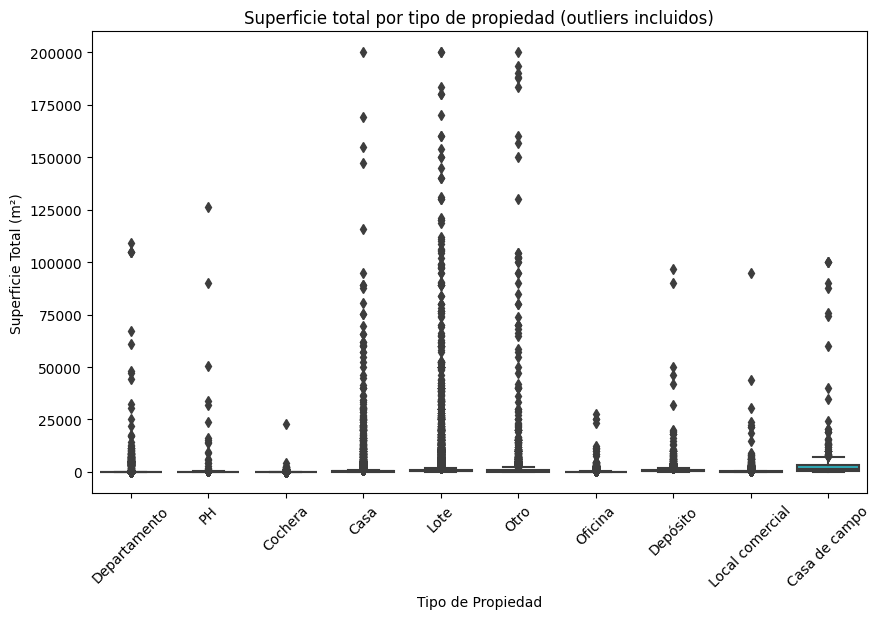

In [25]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10,6))
sns.boxplot(data=df3, x='property_type', y='surface_total')
plt.title('Superficie total por tipo de propiedad (outliers incluidos)')
plt.xlabel('Tipo de Propiedad')
plt.ylabel('Superficie Total (m²)')
plt.xticks(rotation=45)
plt.show()

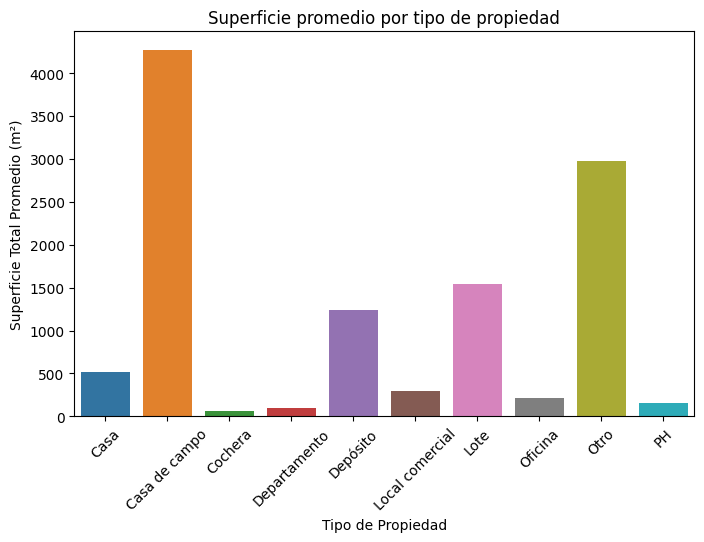

In [26]:
df_superficie = df3.groupby('property_type')['surface_total'].mean().reset_index()

plt.figure(figsize=(8,5))
sns.barplot(data=df_superficie, x='property_type', y='surface_total')
plt.title('Superficie promedio por tipo de propiedad')
plt.xlabel('Tipo de Propiedad')
plt.ylabel('Superficie Total Promedio (m²)')
plt.xticks(rotation=45)
plt.show()

In [27]:
import plotly.express as px
import pandas as pd

# Calcular el precio promedio por tipo de propiedad y provincia
price_mean = (
    df3.groupby(['state_name', 'property_type'], as_index=False)['surface_total']
    .mean()
    .dropna()
)

# Crear el gráfico
fig = px.bar(
    price_mean,
    x='state_name',
    y='surface_total',
    color='property_type',
    barmode='group',
    title='Superficie total promedio según Tipo de Propiedad y Provincia',
    labels={
        'state_name': 'Provincia',
        'surface_total': 'Superficie promedio',
        'property_type': 'Tipo de propiedad'
    }
)

fig.update_layout(
    xaxis_tickangle=-45,
    title_x=0.5,
    yaxis_ticksuffix=' M2',
    legend_title_text='Tipo de propiedad'
)

fig.show()


In [28]:
#Base con DEpartamento PH
PH_DEP_filtrar = [ 'Departamento', 'PH']
PH_DEP=df3.loc[df3['property_type'].isin(PH_DEP_filtrar) ]

import plotly.express as px

#fig = px.box(
#    PH_DEP,
#    x='property_type',
#    y='surface_total',
#    points='all',  # muestra puntos individuales
#    title='Distribución de superficie total por tipo de propiedad',
#    labels={'property_type': 'Tipo de Propiedad', 'surface_total': 'Superficie Total (m²)'}
#)
#fig.show()

## Ambientes, dormitorios, baños

In [29]:
print(f"Hay {df3['rooms'].isna().sum()} Nulos en Ambientes")
print(f"Hay {df3['rooms'].isna().sum()/df3.shape[0]*100} % de Nulos en Ambientes")
print(f"HAy {df3['bedrooms'].isna().sum()} Nulos en Dormitorios")
print(f"Hay {df3['bedrooms'].isna().sum()/df3.shape[0]*100} % de Nulos en Dormitorios")
print(f"HAy {df3['bathrooms'].isna().sum()} Nulos en Baños")
print(f"Hay {df3['bathrooms'].isna().sum()/df3.shape[0]*100} % de Nulos en Baños")

Hay 152224 Nulos en Ambientes
Hay 38.57277880402695 % de Nulos en Ambientes
HAy 194501 Nulos en Dormitorios
Hay 49.28555319898338 % de Nulos en Dormitorios
HAy 79322 Nulos en Baños
Hay 20.099786894924755 % de Nulos en Baños


In [30]:
# Contar nulos por tipo de propiedad
freq_nulos = (
    df3.groupby('property_type')
    .apply(lambda x: pd.Series({
        'rooms_nulos': x['rooms'].isna().sum(),
        'bedrooms_nulos': x['bedrooms'].isna().sum(),
        'bathrooms_nulos': x['bathrooms'].isna().sum(),
        'total_filas': len(x)
    }))
    .reset_index()
)

# Agregar proporciones (%)
freq_nulos['pct_rooms_nulos'] = (freq_nulos['rooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bedrooms_nulos'] = (freq_nulos['bedrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bathrooms_nulos'] = (freq_nulos['bathrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)

freq_nulos

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3236\249354580.py:4: FutureWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,property_type,rooms_nulos,bedrooms_nulos,bathrooms_nulos,total_filas,pct_rooms_nulos,pct_bedrooms_nulos,pct_bathrooms_nulos
0,Casa,28224,23609,6130,87088,32.41,27.11,7.04
1,Casa de campo,187,237,76,798,23.43,29.70,9.52
2,Cochera,3762,4295,5592,5729,65.67,74.97,97.61
3,Departamento,12217,50988,7977,160160,7.63,31.84,4.98
4,Depósito,1700,1913,2248,2682,63.39,71.33,83.82
5,Local comercial,7902,9152,4365,10604,74.52,86.31,41.16
6,Lote,30832,32227,35078,36081,85.45,89.32,97.22
7,Oficina,5185,7064,2094,8295,62.51,85.16,25.24
8,Otro,60775,61241,14643,62817,96.75,97.49,23.31
9,PH,1440,3775,1119,20387,7.06,18.52,5.49


In [31]:
import plotly.express as px
import pandas as pd

# Calcular promedios por tipo de propiedad
promedios = (
    df3.groupby('property_type')[['rooms', 'bedrooms', 'bathrooms']]
    .mean()
    .reset_index()
    .melt(id_vars='property_type', var_name='variable', value_name='promedio')
)

# Crear gráfico de barras
fig = px.bar(
    promedios,
    x='property_type',
    y='promedio',
    color='variable',
    barmode='group',
    title='Promedio de Rooms, Bedrooms y Bathrooms según Tipo de Propiedad',
    labels={
        'property_type': 'Tipo de propiedad',
        'promedio': 'Promedio',
        'variable': 'Variable'
    }
)

fig.update_layout(
    xaxis_tickangle=-45,
    yaxis_title='Promedio',
    legend_title_text='Variable',
    title_x=0.5
)

fig.show()



## Ubicación (`place_name`, `state_name`, `lat`, `lon`)

In [32]:
df3.columns

Index(['id', 'ad_type', 'start_date', 'end_date', 'created_on', 'lat', 'lon',
       'country_name', 'state_name', 'place_name', 'l4', 'l5', 'l6', 'rooms',
       'bedrooms', 'bathrooms', 'surface_total', 'surface_covered', 'currency',
       'price_period', 'title', 'description', 'property_type',
       'operation_type', 'price'],
      dtype='object')

In [33]:
# Resumen general de las variables
df3[['place_name', 'state_name', 'lat', 'lon']].info()

print(f"Hay {df3['place_name'].isna().sum()} Nulos en place_name")
print(f"Hay {df3['place_name'].isna().sum()/df3.shape[0]*100} % de Nulos en place_name")

print(f"Hay {df3['state_name'].isna().sum()} Nulos en state_name")
print(f"Hay {df3['state_name'].isna().sum()/df3.shape[0]*100} % de Nulos en state_name")

print(f"Hay {df3['lat'].isna().sum()} Nulos en lat")
print(f"Hay {df3['lat'].isna().sum()/df3.shape[0]*100} % de Nulos en lat")
print(f"Hay {df3['lon'].isna().sum()} Nulos en lon")
print(f"Hay {df3['lon'].isna().sum()/df3.shape[0]*100} % de Nulos en lon")


<class 'pandas.core.frame.DataFrame'>
Index: 394641 entries, 0 to 992186
Data columns (total 4 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   place_name  373240 non-null  object 
 1   state_name  394641 non-null  object 
 2   lat         331477 non-null  float64
 3   lon         331923 non-null  float64
dtypes: float64(2), object(2)
memory usage: 15.1+ MB
Hay 21401 Nulos en place_name
Hay 5.422903347599464 % de Nulos en place_name
Hay 0 Nulos en state_name
Hay 0.0 % de Nulos en state_name
Hay 63164 Nulos en lat
Hay 16.005432785747047 % de Nulos en lat
Hay 62718 Nulos en lon
Hay 15.892418679255323 % de Nulos en lon


In [34]:
import pandas as pd

state_counts = df3['state_name'].value_counts().reset_index()
state_counts.columns = ['state_name', 'cantidad']
display(state_counts.head(10))
import plotly.express as px

fig = px.bar(
    state_counts,
    x='state_name',
    y='cantidad',
    title='Cantidad de propiedades por provincia (state_name)',
    labels={'state_name': 'Provincia', 'cantidad': 'Cantidad de propiedades'}
)
fig.update_layout(xaxis_tickangle=-45)
fig.show()


,state_name,cantidad
0,Capital Federal,169054
1,Bs.As. G.B.A. Zona Norte,85377
2,Bs.As. G.B.A. Zona Sur,84958
3,Bs.As. G.B.A. Zona Oeste,55252


<Axes: xlabel='state_name'>

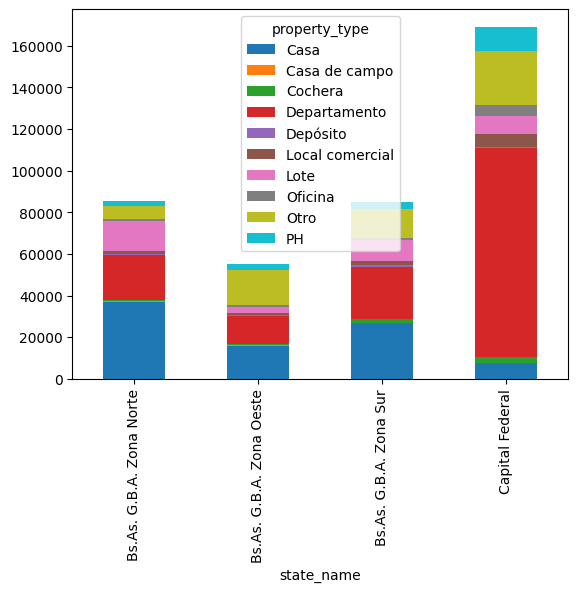

In [35]:
# Podemos graficar la cantidad de casos según dzona y tipo de propiedad
data_agr = df3.groupby(["state_name","property_type"])["id"].count().unstack()
data_agr.plot(kind="bar",stacked=True)

In [36]:
df3['place_name'].unique()

array(['Colegiales', 'Almagro', 'Villa Urquiza', 'Boedo', 'San Telmo',
       'Barrio Norte', 'Villa Devoto', 'Palermo', 'Monserrat',
       'Caballito', 'Balvanera', 'Villa Ortuzar', nan, 'Villa Crespo',
       'Once', 'Saavedra', 'La Plata', 'Recoleta', 'Villa General Mitre',
       'Villa del Parque', 'Belgrano', 'Mataderos', 'Floresta', 'Coghlan',
       'Flores', 'Velez Sarsfield', 'Parque Chacabuco', 'Nuñez',
       'Constitución', 'Las Cañitas', 'Villa Riachuelo', 'Puerto Madero',
       'Paternal', 'Congreso', 'Parque Centenario', 'Parque Patricios',
       'Pompeya', 'Villa Lugano', 'San Cristobal', 'Villa Real',
       'San Nicolás', 'Boca', 'Versalles', 'Villa Luro', 'Retiro',
       'Chacarita', 'Barracas', 'Monte Castro', 'Villa Pueyrredón',
       'Parque Avellaneda', 'Liniers', 'Abasto', 'Tribunales',
       'Centro / Microcentro', 'Villa Santa Rita', 'Agronomía',
       'Parque Chas', 'Villa Soldati', 'Catalinas', 'Tigre', 'Pilar',
       'Escobar', 'San Isidro', 'Esteb

In [37]:
place_counts = df3['place_name'].value_counts().head(20)
print(place_counts)
fig = px.bar(
    place_counts,
    x=place_counts.index,
    y=place_counts.values,
    title='Top 20 localidades con más publicaciones',
    labels={'x': 'Localidad', 'y': 'Cantidad de propiedades'}
)
fig.update_layout(xaxis_tickangle=-45)
fig.show()


place_name
La Plata              26376
Tigre                 26281
Palermo               20487
Lomas de Zamora       17107
Pilar                 13604
Morón                 13142
Almagro               11395
Escobar               11266
Ituzaingó             11119
Belgrano              11067
Villa Crespo          10812
La Matanza             9623
Quilmes                9380
Caballito              9221
San Isidro             8487
General San Martín     7927
Vicente López          7500
Lanús                  7474
Recoleta               7388
Almirante Brown        6717
Name: count, dtype: int64


In [38]:
print(f"Hay {df3['lat'].isna().sum()} Nulos en lat")
print(f"Hay {df3['lat'].isna().sum()/df3.shape[0]*100} % de Nulos en lat")
print(f"Hay {df3['lon'].isna().sum()} Nulos en lon")
print(f"Hay {df3['lon'].isna().sum()/df3.shape[0]*100} % de Nulos en lon")
# Ver rangos de coordenadas
print("Latitud mínima:", df3['lat'].min())
print("Latitud máxima:", df3['lat'].max())
print("Longitud mínima:", df3['lon'].min())
print("Longitud máxima:", df3['lon'].max())


Hay 63164 Nulos en lat
Hay 16.005432785747047 % de Nulos en lat
Hay 62718 Nulos en lon
Hay 15.892418679255323 % de Nulos en lon
Latitud mínima: -180.0
Latitud máxima: -53.8285784574
Longitud mínima: -53.788249
Longitud máxima: 85.0511287798


En Argentina deberían rondar en 
Latitudes: aprox. -55 a -22
Longitudes: aprox. -75 a -53
Parecerían estar invertidos, es más si en el gráfico cambio lat por lon y viceversa, me da mejor el gráfico
Vemos que no son muy confiables y además tienen muchos nulos, por lo que luego voy a eliminar las variables lat y lon

In [39]:
#invierto lan por lon
fig = px.scatter_mapbox(
    df3,
    lat='lon',
    lon='lat',
    hover_name='place_name',
    hover_data=['state_name'],
    color='state_name',
    zoom=3,
    height=600,
    title='Mapa de propiedades por ubicación geográfica'
)

fig.update_layout(mapbox_style='open-street-map')
fig.show()


C:\Users\Usuario\AppData\Local\Temp\ipykernel_3236\2521325293.py:2: DeprecationWarning:

*scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



## Tipo de propiedad (`property_type`)

In [40]:
print(f"Hay {df3['property_type'].isna().sum()} Nulos en property_type")
print(f"Hay {df3['property_type'].isna().sum()/df3.shape[0]*100} % de Nulos en property_typet")

Hay 0 Nulos en property_type
Hay 0.0 % de Nulos en property_typet


<Axes: title={'center': 'Q DE CASOS POR TIPO DE PROPIEDAD'}, xlabel='property_type'>

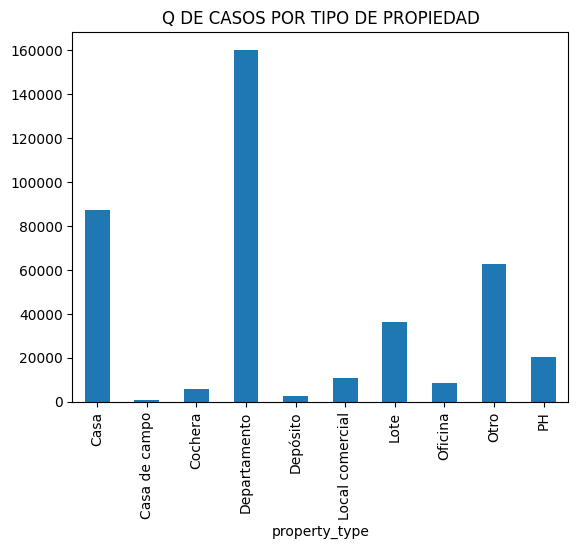

In [41]:
# Realizamos un gráfico de barras que cuente los casos por tipo de propiedad
tipo_propiedad=df3.groupby('property_type').count()['id']
tipo_propiedad.plot(kind='bar', title="Q DE CASOS POR TIPO DE PROPIEDAD")

<Axes: xlabel='property_type'>

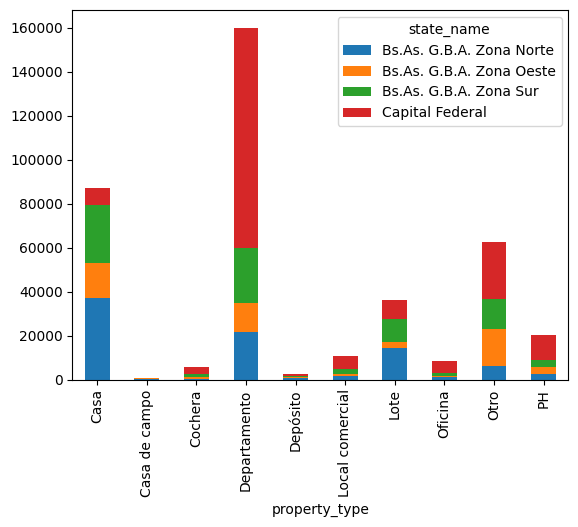

In [42]:
# Podemos graficar la cantidad de casos según el tipo de porpiedad y la zona
data_agr = df3.groupby(["property_type","state_name"])["id"].count().unstack()
data_agr.plot(kind="bar",stacked=True)

In [43]:
print(data_agr)

state_name       Bs.As. G.B.A. Zona Norte  Bs.As. G.B.A. Zona Oeste  \
property_type                                                         
Casa                                37061                     15847   
Casa de campo                         236                       321   
Cochera                               489                       612   
Departamento                        21484                     13271   
Depósito                              679                       477   
Local comercial                      1641                      1054   
Lote                                14158                      3158   
Oficina                              1243                       538   
Otro                                 5972                     16869   
PH                                   2414                      3105   

state_name       Bs.As. G.B.A. Zona Sur  Capital Federal  
property_type                                             
Casa                         

## Precio (`price`)

In [44]:
print(f"Hay {df3['price'].isna().sum()} Nulos en price")
print(f"Hay {df3['price'].isna().sum()/df3.shape[0]*100} % de Nulos en price")

Hay 0 Nulos en price
Hay 0.0 % de Nulos en price


In [45]:
import plotly.express as px
import pandas as pd

# Calcular promedios por tipo de propiedad
promedios = (
    df3.groupby('property_type')[['price']]
    .mean()
    .reset_index()
    .melt(id_vars='property_type', var_name='variable', value_name='promedio')
)

# Crear gráfico de barras
fig = px.bar(
    promedios,
    x='property_type',
    y='promedio',
    color='variable',
    barmode='group',
    title='Promedio de price según Tipo de Propiedad',
    labels={
        'property_type': 'Tipo de propiedad',
        'promedio': 'Promedio',
        'variable': 'Variable'
    }
)

fig.update_layout(
    xaxis_tickangle=-45,
    yaxis_title='Promedio',
    legend_title_text='Variable',
    title_x=0.5
)

fig.show()

In [46]:
import plotly.express as px
import pandas as pd

# Calcular el precio promedio por tipo de propiedad y provincia
price_mean = (
    df3.groupby(['state_name', 'property_type'], as_index=False)['price']
    .mean()
    .dropna()
)

# Crear el gráfico
fig = px.bar(
    price_mean,
    x='state_name',
    y='price',
    color='property_type',
    barmode='group',
    title='Precio promedio según Tipo de Propiedad y Provincia',
    labels={
        'state_name': 'Provincia',
        'price': 'Precio promedio',
        'property_type': 'Tipo de propiedad'
    }
)

fig.update_layout(
    xaxis_tickangle=-45,
    title_x=0.5,
    yaxis_tickprefix='$ ',
    legend_title_text='Tipo de propiedad'
)

fig.show()


Vemos que los precios promedios en capital federal son más elevados que en el resto de las zonas (excepto en tipo de propiedad casa de campo y depósitos).
Casa de campo son solo 5 en capital federal, lo cual no es un precio muy representativo respecto al total de casas de campo
Depósitos, el precio promedio en zona norte lo supera ampliamente , pero si vamos al gráfico de superficie promedio vemos que en zona norte la superficie promedio es de 1563 m2 contra 783 m2 en capital federal

In [47]:
#Detalle de los precios promedios por zona y tipo de propiedad
print(price_mean)

                  state_name    property_type          price
0   Bs.As. G.B.A. Zona Norte             Casa  404985.565797
1   Bs.As. G.B.A. Zona Norte    Casa de campo  300875.847458
2   Bs.As. G.B.A. Zona Norte          Cochera   19265.294479
3   Bs.As. G.B.A. Zona Norte     Departamento  201461.052830
4   Bs.As. G.B.A. Zona Norte         Depósito  995278.533137
5   Bs.As. G.B.A. Zona Norte  Local comercial  452817.860451
6   Bs.As. G.B.A. Zona Norte             Lote  262650.460588
7   Bs.As. G.B.A. Zona Norte          Oficina  290647.231698
8   Bs.As. G.B.A. Zona Norte             Otro  327657.069156
9   Bs.As. G.B.A. Zona Norte               PH  178048.188484
10  Bs.As. G.B.A. Zona Oeste             Casa  211854.736669
11  Bs.As. G.B.A. Zona Oeste    Casa de campo  206736.760125
12  Bs.As. G.B.A. Zona Oeste          Cochera   27789.681373
13  Bs.As. G.B.A. Zona Oeste     Departamento  108268.762565
14  Bs.As. G.B.A. Zona Oeste         Depósito  483949.895178
15  Bs.As. G.B.A. Zona O

###  4. **Limpieza y tratamiento de datos**

## Limpieza Superficie

In [48]:
print(f"Hay {df3['surface_total'].isna().sum()} Nulos en Superficie Total")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total")
print(f"HAy {df3['surface_covered'].isna().sum()} Nulos en Superficie Cubierta")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total")

Hay 188735 Nulos en Superficie Total
Hay 47.824478450034334 % de Nulos en Superficie Total
HAy 194154 Nulos en Superficie Cubierta
Hay 47.824478450034334 % de Nulos en Superficie Total


In [49]:
# Filas donde surface_total y surface_covered son ambos nulos
nulos_ambos = df3[df3['surface_total'].isna() & df3['surface_covered'].isna()]
print(f"Cantidad de filas con ambos nulos: {len(nulos_ambos)}")
pct_nulos_ambos = len(nulos_ambos) / len(df3) * 100
print(f"{pct_nulos_ambos:.2f}% de las filas tienen ambas superficies nulas")

Cantidad de filas con ambos nulos: 169727
43.01% de las filas tienen ambas superficies nulas


In [50]:
df3[['surface_total','surface_covered']].describe(include='all')

,surface_total,surface_covered
count,205906.000000,2.004870e+05
mean,396.662545,1.820329e+02
std,3220.737320,3.428369e+03
min,-200.000000,-1.700000e+02
25%,54.000000,4.700000e+01
50%,100.000000,7.800000e+01
75%,258.000000,1.550000e+02
max,200000.000000,1.350000e+06


Intento de salvar Superficie con lo que dice la descripcion

In [51]:
import re
import numpy as np

# Función para extraer superficie desde texto
def extraer_superficie(texto):
    if isinstance(texto, str):
        match = re.search(r'(\d+)\s*(m²|metros cuadrados)', texto, flags=re.IGNORECASE)
        if match:
            return int(match.group(1))
    return np.nan

# Crear columna auxiliar
#df3['surface_extraida'] = df3.apply(
#    lambda x: extraer_superficie(x['title'] + ' ' + str(x['description'])), axis=1
#)
# Combinar textos de forma segura
df3['texto_completo'] = df3[['title', 'description']].astype(str).agg(' '.join, axis=1)

# Aplicar el extractor
df3['surface_extraida'] = df3['texto_completo'].apply(extraer_superficie)


In [52]:
df3.head(5)

,id,ad_type,start_date,end_date,created_on,lat,lon,country_name,state_name,place_name,...,surface_covered,currency,price_period,title,description,property_type,operation_type,price,texto_completo,surface_extraida
0,556713,Propiedad,2019-11-29,9999-12-31,2019-11-29,-58.442399,-34.573623,Argentina,Capital Federal,Colegiales,...,NaN,USD,NaN,"Departamento en Venta en Belgrano, Capital fed...","Sup total por escritura: 96,47 m2 (cubiertos: ...",Departamento,Venta,259000.0,"Departamento en Venta en Belgrano, Capital fed...",NaN
1,192912,Propiedad,2020-06-05,2020-06-08,2020-06-05,-58.430493,-34.606620,Argentina,Capital Federal,Almagro,...,67.0,USD,NaN,Departamento de 3 ambientes en Venta en Almagro,Excelente departamento de tres ambientes ampli...,Departamento,Venta,235500.0,Departamento de 3 ambientes en Venta en Almagr...,NaN
2,238224,Propiedad,2020-07-01,9999-12-31,2020-07-01,-58.491760,-34.574123,Argentina,Capital Federal,Villa Urquiza,...,55.0,USD,NaN,Andonaegui 2600 4° - - Departamento en Venta,Excelente 3 ambientes al frente con balcón. Vi...,Departamento,Venta,175000.0,Andonaegui 2600 4° - - Departamento en Ven...,NaN
3,257134,Propiedad,2019-08-17,9999-12-31,2019-08-17,-58.420737,-34.631770,Argentina,Capital Federal,Boedo,...,47.0,USD,NaN,PH Venta Boedo 2 amb Patio,Corredor Responsable: MARCELO TRUJILLO - CPI ...,PH,Venta,140000.0,PH Venta Boedo 2 amb Patio Corredor Responsabl...,NaN
4,521738,Propiedad,2019-08-05,2019-08-31,2019-08-05,-58.429983,-34.607225,Argentina,Capital Federal,Almagro,...,64.0,USD,NaN,Venta 3 Ambientes - Almagro - Balcón - Ameniti...,Corredor Responsable: Marcelo Trujillo - CUCIC...,Departamento,Venta,173000.0,Venta 3 Ambientes - Almagro - Balcón - Ameniti...,NaN


In [53]:
print(f"Hay {df3['surface_total'].isna().sum()} Nulos en Superficie Total pre imputación")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total pre imputación")
df3['surface_total'] = df3['surface_total'].fillna(df3['surface_extraida'])
print(f"Hay {df3['surface_total'].isna().sum()} Nulos en Superficie Total post imputación")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total post imputación")

Hay 188735 Nulos en Superficie Total pre imputación
Hay 47.824478450034334 % de Nulos en Superficie Total pre imputación
Hay 184964 Nulos en Superficie Total post imputación
Hay 46.86892644200679 % de Nulos en Superficie Total post imputación


Logro encontrar 3771 filas que estaban en nulos

In [54]:
df3['surface_discovered'] = df3['surface_total'] - df3['surface_covered']


Cálculo superficie descubierta y elimino las filas qeu la superficie cubierta es mayor que la superficie total

In [55]:
df3.loc[df3['surface_discovered'] < 0, 'flag_superficie'] = 'Error: cubierta > total'


In [56]:
print(f"Número de filas: {df3.shape[0]}")
neg=df3[df3['surface_discovered'] < 0]
print(f"Cuantos tienen flag_superficie con 'Error: cubierta > total': {len(neg)} filas")
#Elimino los que tienen superficie Cubierta mayor a la Superficie total
df3 = df3.drop(neg.index)
#df3 = df3[df3['surface_discovered'] >= 0]
print(f"Número de filas post eliminación: {df3.shape[0]}")

Número de filas: 394641
Cuantos tienen flag_superficie con 'Error: cubierta > total': 3195 filas
Número de filas post eliminación: 391446


Elimino las que cuentan con superficie total y cubierta negativas

In [57]:
print(f"Número de filas: {df3.shape[0]}")
#Cuento cuantas propiedades cuentan con superficie total y cubierta menor o igual
negativas = df3[(df3['surface_total'] <= 0) | (df3['surface_covered'] <= 0)]
print(f"Filas con superficies negativas: {len(negativas)}")
#Elimino los que tienen superficie Negariva o igual a 0
df3 = df3.drop(negativas.index)
#df3 = df3[(df3['surface_total'] > 0) & (df3['surface_covered'] > 0)]
print(f"Número de filas post eliminación: {df3.shape[0]}")

Número de filas: 391446
Filas con superficies negativas: 160
Número de filas post eliminación: 391286


In [58]:
#Calculo la superficie descubierta para aquellos que complete, aunque deberia ser 0
df3['surface_discovered'] = df3['surface_total'] - df3['surface_covered']

Elimino las que en ambas superficie (total y cubierta) es NAN, ya que la superficie es una variable importante en el momento de predecir el precio

In [59]:
print(f"Número de filas: {df3.shape[0]}")
#Elimino las que en ambas superficie es NAN ya que la superficie es una variable importante en el momento de predecir el precio
nulos_ambos2 = df3[df3['surface_total'].isna() & df3['surface_covered'].isna()]
print(f"Cantidad de filas con ambos nulos: {len(nulos_ambos2)}")
#Elimino las filas que tengan nulos en simultaneo en surface_total, surface_covered
df3 = df3.drop(nulos_ambos2.index)
print(f"Número de filas post eliminación: {df3.shape[0]}")

Número de filas: 391286
Cantidad de filas con ambos nulos: 166572
Número de filas post eliminación: 224714


In [60]:
print(f"Hay {df3['surface_total'].isna().sum()} Nulos en Superficie Total")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total")
print(f"HAy {df3['surface_covered'].isna().sum()} Nulos en Superficie Cubierta")
print(f"Hay {df3['surface_covered'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie cubierta")
corr = df3[['surface_total','surface_covered']].corr().iloc[0,1]
print(f"Correlación entre total y cubierta: {corr:.2f}")

Hay 18392 Nulos en Superficie Total
Hay 8.184625791005457 % de Nulos en Superficie Total
HAy 27422 Nulos en Superficie Cubierta
Hay 12.203067009621119 % de Nulos en Superficie cubierta
Correlación entre total y cubierta: 0.49


Bajo el supuesto que la superficie total es igual a la descubierta,  los valores nan de total los completo con la de superficie cubierta y los de cubierta con lo de total

In [61]:
#Bajo el supuesto que la sup total es igual a la descubierta los valores nan de total
#los completo con la de superficie cubierta y los de cubierta con lo de total
df3['surface_total'] = df3['surface_total'].fillna(df3['surface_covered'])
df3['surface_covered'] = df3['surface_covered'].fillna(df3['surface_total'])

In [62]:
print(f"Hay {df3['surface_total'].isna().sum()} Nulos en Superficie Total")
print(f"Hay {df3['surface_total'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie Total")
print(f"HAy {df3['surface_covered'].isna().sum()} Nulos en Superficie Cubierta")
print(f"Hay {df3['surface_covered'].isna().sum()/df3.shape[0]*100} % de Nulos en Superficie cubierta")
corr = df3[['surface_total','surface_covered']].corr().iloc[0,1]
print(f"Correlación entre total y cubierta: {corr:.2f}")

Hay 0 Nulos en Superficie Total
Hay 0.0 % de Nulos en Superficie Total
HAy 0 Nulos en Superficie Cubierta
Hay 0.0 % de Nulos en Superficie cubierta
Correlación entre total y cubierta: 0.94


Al completar los valores de Sup Total y Sup Cubierta con el opuesto la correlacion entre estas dos variables aumenta de 0,49 a 0,94 ; valor a tener en cuenta para el análisis de variables

Cuantos elimino por Limpiar variables de superficies

In [63]:
print(f"Número de filas pre análisis de Superficie: {df2.shape[0]}")
print(f"Número de filas post análisis de Superficie: {df3.shape[0]}")
print(f"Eliminamos en el análisis de Superficie: {df2.shape[0]-df3.shape[0]} filas")

Número de filas pre análisis de Superficie: 394641
Número de filas post análisis de Superficie: 224714
Eliminamos en el análisis de Superficie: 169927 filas


In [64]:
#veo las principales medidas de las 4 variables para ver que no queden negativos y demás
df3[['surface_total','surface_covered','surface_discovered','surface_extraida']].describe(include='all')

,surface_total,surface_covered,surface_discovered,surface_extraida
count,2.247140e+05,2.247140e+05,178900.000000,18052.000000
mean,3.954054e+02,2.996748e+02,120.245914,590.339575
std,4.294801e+03,4.005169e+03,1675.699574,6423.297965
min,1.000000e+00,1.000000e+00,0.000000,0.000000
25%,5.400000e+01,4.800000e+01,0.000000,52.000000
50%,1.000000e+02,8.500000e+01,6.000000,110.000000
75%,2.500000e+02,1.900000e+02,29.000000,445.750000
max,1.350000e+06,1.350000e+06,289765.000000,501000.000000


In [65]:
print("\nComo me queda el dataset")
print(f"Número de filas: {df3.shape[0]}")
print(f"Número de columnas: {df3.shape[1]}")


Como me queda el dataset
Número de filas: 224714
Número de columnas: 29


## Limpieza Ambientes, dormitorios, baños

In [66]:
df4=df3.copy()

In [67]:
print(f"Hay {df4['rooms'].isna().sum()} Nulos en Ambientes")
print(f"Hay {df4['rooms'].isna().sum()/df4.shape[0]*100} % de Nulos en Ambientes")
print(f"HAy {df4['bedrooms'].isna().sum()} Nulos en Dormitorios")
print(f"Hay {df4['bedrooms'].isna().sum()/df4.shape[0]*100} % de Nulos en Dormitorios")
print(f"HAy {df4['bathrooms'].isna().sum()} Nulos en Baños")
print(f"Hay {df4['bathrooms'].isna().sum()/df4.shape[0]*100} % de Nulos en Baños")

Hay 64778 Nulos en Ambientes
Hay 28.82686436982119 % de Nulos en Ambientes
HAy 101395 Nulos en Dormitorios
Hay 45.12179926484331 % de Nulos en Dormitorios
HAy 34261 Nulos en Baños
Hay 15.246491095347864 % de Nulos en Baños


In [68]:
# Contar nulos por tipo de propiedad
freq_nulos = (
    df4.groupby('property_type')
    .apply(lambda x: pd.Series({
        'rooms_nulos': x['rooms'].isna().sum(),
        'bedrooms_nulos': x['bedrooms'].isna().sum(),
        'bathrooms_nulos': x['bathrooms'].isna().sum(),
        'total_filas': len(x)
    }))
    .reset_index()
)

# Agregar proporciones (%)
freq_nulos['pct_rooms_nulos'] = (freq_nulos['rooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bedrooms_nulos'] = (freq_nulos['bedrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bathrooms_nulos'] = (freq_nulos['bathrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)

freq_nulos

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3236\731199028.py:4: FutureWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,property_type,rooms_nulos,bedrooms_nulos,bathrooms_nulos,total_filas,pct_rooms_nulos,pct_bedrooms_nulos,pct_bathrooms_nulos
0,Casa,22545,17565,1761,55798,40.40,31.48,3.16
1,Casa de campo,164,192,19,502,32.67,38.25,3.78
2,Cochera,2057,2119,2067,2130,96.57,99.48,97.04
3,Departamento,4727,40993,2977,112325,4.21,36.49,2.65
4,Depósito,1455,1518,1292,1556,93.51,97.56,83.03
5,Local comercial,6717,7477,2645,7646,87.85,97.79,34.59
6,Lote,19452,20034,19960,20649,94.20,97.02,96.66
7,Oficina,4604,5762,1522,6187,74.41,93.13,24.60
8,Otro,2337,2677,1597,3241,72.11,82.60,49.27
9,PH,720,3058,421,14680,4.90,20.83,2.87


Trato de encontrar información en descripcion y titulo de la cantidad de ambientes y dormitorios

In [69]:
import re
import numpy as np

def extraer_rooms_bedrooms(texto):
    if not isinstance(texto, str):
        return pd.Series({'rooms_extraida': np.nan, 'bedrooms_extraida': np.nan})

    texto = texto.lower()

    # Caso especial: monoambiente o mono amb
    if re.search(r'mono\s*amb', texto):
        return pd.Series({'rooms_extraida': 1, 'bedrooms_extraida': 1})

    # Buscar ambientes explícitos con número
    match_rooms = re.search(r'(\d+)\s*(amb(?:\.|ientes)?)', texto)
    # Buscar dormitorios explícitos con número
    match_bed = re.search(r'(\d+)\s*(dorm(?:\.|itorio|itorios)?|cuartos?)', texto)

    rooms = int(match_rooms.group(1)) if match_rooms else np.nan
    bedrooms = int(match_bed.group(1)) if match_bed else np.nan

    return pd.Series({'rooms_extraida': rooms, 'bedrooms_extraida': bedrooms})

In [70]:
#Aplicar sobre title + description
df4['texto_completo'] = df4[['title', 'description']].astype(str).agg(' '.join, axis=1)
df4[['rooms_extraida', 'bedrooms_extraida']] = df4['texto_completo'].apply(extraer_rooms_bedrooms)

In [71]:
#TOMO In id que tiene nan y recupero a modo de ejemplo
dd=df4[df4['id']==999935]
dd

,id,ad_type,start_date,end_date,created_on,lat,lon,country_name,state_name,place_name,...,description,property_type,operation_type,price,texto_completo,surface_extraida,surface_discovered,flag_superficie,rooms_extraida,bedrooms_extraida
992126,999935,Propiedad,2020-01-09,2020-01-24,2020-01-09,-58.41439,-34.60718,Argentina,Capital Federal,Almagro,...,"Casa de 13 Habitaciones, 8 baños, Local Comer...",Casa,Venta,680000.0,Casa de 8 ambientes en Venta en Almagro Casa d...,NaN,220.0,NaN,8.0,NaN


In [72]:
completados_rooms = df4['rooms'].isna().sum()
completados_bedrooms = df4['bedrooms'].isna().sum()

print("Filas con Ambientes nulos:", completados_rooms)
print("Filas con Baños nulos:", completados_bedrooms)

#Completar los valores nulos en las columnas reales
df4['rooms'] = df4['rooms'].fillna(df4['rooms_extraida'])
df4['bedrooms'] = df4['bedrooms'].fillna(df4['bedrooms_extraida'])

df4[['title', 'description', 'rooms', 'rooms_extraida']].sample(10)


print("Filas con Ambientes aún nulos:",df4['rooms'].isna().sum())
print("Filas con Ambientes aún nulos:",df4['bedrooms'].isna().sum())

Filas con Ambientes nulos: 64778
Filas con Baños nulos: 101395
Filas con Ambientes aún nulos: 49922
Filas con Ambientes aún nulos: 74965


Encuentro 14856 filas cons ambientes nuelos y 26430 con dormitorios nulos

In [73]:
#ahora con lal variable ambiente y dormitorio completo
dd=df4[df4['id']==999935]
dd

,id,ad_type,start_date,end_date,created_on,lat,lon,country_name,state_name,place_name,...,description,property_type,operation_type,price,texto_completo,surface_extraida,surface_discovered,flag_superficie,rooms_extraida,bedrooms_extraida
992126,999935,Propiedad,2020-01-09,2020-01-24,2020-01-09,-58.41439,-34.60718,Argentina,Capital Federal,Almagro,...,"Casa de 13 Habitaciones, 8 baños, Local Comer...",Casa,Venta,680000.0,Casa de 8 ambientes en Venta en Almagro Casa d...,NaN,220.0,NaN,8.0,NaN


In [74]:
#Verificación
df4[['title', 'description', 'rooms', 'bedrooms', 'rooms_extraida', 'bedrooms_extraida']].sample(10)

,title,description,rooms,bedrooms,rooms_extraida,bedrooms_extraida
689540,OPORTUNIDAD! PISO SÚPER LUMINOSO EN ESQUINA C/...,Excelente y Elegante Piso en Pleno Belgrano. T...,4.0,3.0,NaN,3.0
66672,Venta - Casa - Indio Cua Golf Club,Casa en dos Plantas de 130 m² sobre lote de 70...,5.0,NaN,NaN,NaN
332053,Departamento - Villa Luzuriaga,ULTIMAS 3 UNIDADES FUNCIONALES. OPORTUNIDAD!!<...,2.0,1.0,1.0,1.0
25468,Departamento en venta en Recoleta,Excelente departamento en edificio de categor...,3.0,2.0,NaN,2.0
595296,Departamento - Belgrano,Emprendimiento en construcción en Belgrano.<br...,2.0,1.0,NaN,NaN
746758,A estrenar con amenities.,Monoambiente de 50 m2 a estrenar. A contrafren...,1.0,1.0,1.0,1.0
10954,Terreno de 1 ambiente en Venta en Abasto,EXCELENTE ESQUINA ESTRATEGICAMENTE UBICACADA. ...,1.0,NaN,1.0,NaN
636250,Casa a estrenar en Barrio Los Castaños Nordelt...,"Casa en venta a estrenar en barrio Castaños, N...",NaN,3.0,NaN,NaN
979920,"Departamento en Venta, ubicado a dos cuadras d...","Departamento al frente, primer piso por escale...",3.0,2.0,NaN,NaN
115414,Departamento en venta 2 amb. en V. Pueyrredón,Corredor Responsable: Gabriel Sola - CUCICBA 2...,2.0,1.0,2.0,NaN


Bajo el supuesto que en casa, departamento o PH la cantidad de Ambientes, en su gran mayoría suele ser la cantidad de 
dormitorios más uno excepto cuando es monoambiente; completos los datos el uno al otro sumandole uno a los dormitorios o restandole uno a los ambientes para completar dormitorio

Salvo cuando ambientes es 1 (monoambientes) entonces en cuartos tambien pongo 1

In [75]:
tipos_filtrar = ['Casa', 'Casa de campo', 'Departamento', 'PH']

# 1️⃣ Completar rooms nulos con bedrooms + 1
df4.loc[
    df4['property_type'].isin(tipos_filtrar) &
    df4['rooms'].isna() &
    df4['bedrooms'].notna(),
    'rooms'
] = df4['bedrooms'] + 1

# 2️⃣ Completar bedrooms nulos con rooms - 1
df4.loc[
    df4['property_type'].isin(tipos_filtrar) &
    df4['bedrooms'].isna() &
    df4['rooms'].notna(),
    'bedrooms'
] = df4['rooms'] - 1

# 3️⃣ Si rooms == 1 y bedrooms es nulo → bedrooms = 1
df4.loc[
    df4['property_type'].isin(tipos_filtrar) &
    (df4['rooms'] == 1) &
    df4['bedrooms'].isna(),
    'bedrooms'
] = 1


In [76]:
# Contar nulos por tipo de propiedad
freq_nulos = (
    df4.groupby('property_type')
    .apply(lambda x: pd.Series({
        'rooms_nulos': x['rooms'].isna().sum(),
        'bedrooms_nulos': x['bedrooms'].isna().sum(),
        'bathrooms_nulos': x['bathrooms'].isna().sum(),
        'total_filas': len(x)
    }))
    .reset_index()
)

# Agregar proporciones (%)
freq_nulos['pct_rooms_nulos'] = (freq_nulos['rooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bedrooms_nulos'] = (freq_nulos['bedrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bathrooms_nulos'] = (freq_nulos['bathrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)

freq_nulos

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3236\731199028.py:4: FutureWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,property_type,rooms_nulos,bedrooms_nulos,bathrooms_nulos,total_filas,pct_rooms_nulos,pct_bedrooms_nulos,pct_bathrooms_nulos
0,Casa,841,841,1761,55798,1.51,1.51,3.16
1,Casa de campo,17,17,19,502,3.39,3.39,3.78
2,Cochera,2026,2108,2067,2130,95.12,98.97,97.04
3,Departamento,749,749,2977,112325,0.67,0.67,2.65
4,Depósito,1020,1475,1292,1556,65.55,94.79,83.03
5,Local comercial,4802,7330,2645,7646,62.80,95.87,34.59
6,Lote,15804,19733,19960,20649,76.54,95.56,96.66
7,Oficina,3524,5409,1522,6187,56.96,87.43,24.60
8,Otro,1979,2322,1597,3241,61.06,71.64,49.27
9,PH,108,108,421,14680,0.74,0.74,2.87


In [77]:
print(f"Número de filas: {df4.shape[0]}")
#veo cuantos e en ambientes y dormitorios son NAN 
nulos_ambos2 = df4[df4['rooms'].isna() & df4['bedrooms'].isna()]
print(f"Cantidad de filas con ambos nulos: {len(nulos_ambos2)}")


Número de filas: 224714
Cantidad de filas con ambos nulos: 30266


In [78]:
#Elimino los casos de vivienda que tienen amb y dormitorios nulos
tipos_filtrar = ['Casa', 'Casa de campo', 'Departamento', 'PH']

# Crear una máscara con la condición
mask = (
    df4['property_type'].isin(tipos_filtrar) &
    df4['rooms'].isna() &
    df4['bedrooms'].isna()
)

# Contar cuántas filas se eliminarán
print(f"Filas a eliminar: {mask.sum()}")

# Eliminar esas filas
df4 = df4[~mask].copy()

Filas a eliminar: 1715


In [79]:
#para verificar si todavía quedan casos con ambos nulos
df4[(df4['property_type'].isin(tipos_filtrar)) & df4['rooms'].isna() & df4['bedrooms'].isna()]

,id,ad_type,start_date,end_date,created_on,lat,lon,country_name,state_name,place_name,...,description,property_type,operation_type,price,texto_completo,surface_extraida,surface_discovered,flag_superficie,rooms_extraida,bedrooms_extraida


In [80]:
# Contar nulos por tipo de propiedad
freq_nulos = (
    df4.groupby('property_type')
    .apply(lambda x: pd.Series({
        'rooms_nulos': x['rooms'].isna().sum(),
        'bedrooms_nulos': x['bedrooms'].isna().sum(),
        'bathrooms_nulos': x['bathrooms'].isna().sum(),
        'total_filas': len(x)
    }))
    .reset_index()
)

# Agregar proporciones (%)
freq_nulos['pct_rooms_nulos'] = (freq_nulos['rooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bedrooms_nulos'] = (freq_nulos['bedrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bathrooms_nulos'] = (freq_nulos['bathrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)

freq_nulos


C:\Users\Usuario\AppData\Local\Temp\ipykernel_3236\3432671705.py:4: FutureWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,property_type,rooms_nulos,bedrooms_nulos,bathrooms_nulos,total_filas,pct_rooms_nulos,pct_bedrooms_nulos,pct_bathrooms_nulos
0,Casa,0,0,1406,54957,0.00,0.00,2.56
1,Casa de campo,0,0,10,485,0.00,0.00,2.06
2,Cochera,2026,2108,2067,2130,95.12,98.97,97.04
3,Departamento,0,0,2791,111576,0.00,0.00,2.50
4,Depósito,1020,1475,1292,1556,65.55,94.79,83.03
5,Local comercial,4802,7330,2645,7646,62.80,95.87,34.59
6,Lote,15804,19733,19960,20649,76.54,95.56,96.66
7,Oficina,3524,5409,1522,6187,56.96,87.43,24.60
8,Otro,1979,2322,1597,3241,61.06,71.64,49.27
9,PH,0,0,377,14572,0.00,0.00,2.59


Para completar los nulos de los baños , hago :
Si property_type es vivienda ['Casa', 'Casa de campo', 'Departamento', 'PH'] → promedio por property_type y rooms.

Si no → promedio general por property_type

In [81]:
#Se calculan promedios específicos (Casa, Departamento, etc.) por rooms.
#Si no hay coincidencia exacta ((property_type, rooms) no existe), se usa el promedio solo por tipo.
#Si ni eso existe (raro), se usa el promedio global de toda la columna.

import numpy as np
import math

tipos_filtrar = ['Casa', 'Casa de campo', 'Departamento', 'PH']

# --- 1️⃣ Promedio por property_type y rooms (para tipos_filtrar)
prom_tipo_room = (
    df4[df4['property_type'].isin(tipos_filtrar)]
    .groupby(['property_type', 'rooms'])['bathrooms']
    .mean()
)

# --- 2️⃣ Promedio por property_type (para el resto)
prom_tipo = (
    df4[~df4['property_type'].isin(tipos_filtrar)]
    .groupby('property_type')['bathrooms']
    .mean()
)

# --- 3️⃣ Función de completado
def completar_bathrooms(row):
    if not np.isnan(row['bathrooms']):
        return row['bathrooms']

    tipo = row['property_type']
    rooms = row['rooms']
    valor = np.nan

    # Si pertenece a tipos_filtrar → promedio por tipo y rooms
    if tipo in tipos_filtrar:
        if (tipo, rooms) in prom_tipo_room.index:
            valor = prom_tipo_room.loc[(tipo, rooms)]
        elif tipo in prom_tipo.index:
            valor = prom_tipo.get(tipo)
        else:
            valor = df4['bathrooms'].mean()
    else:
        if tipo in prom_tipo.index:
            valor = prom_tipo.get(tipo)
        else:
            valor = df4['bathrooms'].mean()

    # Redondear hacia abajo y asegurar mínimo 1
    valor_final = math.floor(valor) if not np.isnan(valor) else 1
    if valor_final < 1:
        valor_final = 1

    return valor_final

# --- 4️⃣ Aplicar la función
df4['bathrooms'] = df4.apply(completar_bathrooms, axis=1)

In [82]:
# Ver cuántos bathrooms nulos quedan
df4['bathrooms'].isna().sum()


0

In [83]:
prom_tipo_room.head(10)
prom_tipo.head(10)


property_type
Cochera            1.269841
Depósito           2.071970
Local comercial    1.892222
Lote               2.007257
Oficina            1.904609
Otro               2.319343
Name: bathrooms, dtype: float64

In [84]:
neg_1=df4[df4['rooms'] < 0]
neg_2=df4[df4['bedrooms'] < 0]           
print(f"Cuantos tienen Ambientes negativo': {len(neg_1)} filas")
print(f"Cuantos tienen dormitorios': {len(neg_2)} filas")
#Elimino los que tienen superficie Cubierta mayor a la Superficie total
df4 = df4.drop(neg_1.index)
df4 = df4.drop(neg_2.index)

Cuantos tienen Ambientes negativo': 0 filas
Cuantos tienen dormitorios': 2 filas


In [85]:
# Contar nulos por tipo de propiedad
freq_nulos = (
    df4.groupby('property_type')
    .apply(lambda x: pd.Series({
        'rooms_nulos': x['rooms'].isna().sum(),
        'bedrooms_nulos': x['bedrooms'].isna().sum(),
        'bathrooms_nulos': x['bathrooms'].isna().sum(),
        'total_filas': len(x)
    }))
    .reset_index()
)

# Agregar proporciones (%)
freq_nulos['pct_rooms_nulos'] = (freq_nulos['rooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bedrooms_nulos'] = (freq_nulos['bedrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)
freq_nulos['pct_bathrooms_nulos'] = (freq_nulos['bathrooms_nulos'] / freq_nulos['total_filas'] * 100).round(2)

freq_nulos

C:\Users\Usuario\AppData\Local\Temp\ipykernel_3236\731199028.py:4: FutureWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.



,property_type,rooms_nulos,bedrooms_nulos,bathrooms_nulos,total_filas,pct_rooms_nulos,pct_bedrooms_nulos,pct_bathrooms_nulos
0,Casa,0,0,0,54957,0.00,0.00,0.0
1,Casa de campo,0,0,0,485,0.00,0.00,0.0
2,Cochera,2026,2108,0,2130,95.12,98.97,0.0
3,Departamento,0,0,0,111574,0.00,0.00,0.0
4,Depósito,1020,1475,0,1556,65.55,94.79,0.0
5,Local comercial,4802,7330,0,7646,62.80,95.87,0.0
6,Lote,15804,19733,0,20649,76.54,95.56,0.0
7,Oficina,3524,5409,0,6187,56.96,87.43,0.0
8,Otro,1979,2322,0,3241,61.06,71.64,0.0
9,PH,0,0,0,14572,0.00,0.00,0.0


In [86]:
df4.describe()

,id,lat,lon,l6,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,surface_extraida,surface_discovered,rooms_extraida,bedrooms_extraida
count,222997.000000,193524.000000,193524.000000,0.0,193842.000000,184620.000000,222997.000000,2.229970e+05,2.229970e+05,2.229970e+05,17733.000000,177749.000000,125734.000000,6.765600e+04
mean,441422.587313,-58.505011,-34.590743,NaN,3.109527,2.260086,1.784719,3.943064e+02,2.984834e+02,2.981998e+05,578.753905,120.215759,3.519199,7.201220e+08
std,285314.756593,0.426022,0.238907,NaN,5.409039,15.906593,1.052148,4.279069e+03,3.988473e+03,4.802915e+05,6285.476771,1673.527046,125.369606,1.872852e+11
min,3.000000,-71.641798,-53.788249,NaN,0.000000,0.000000,1.000000,1.000000e+00,1.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00
25%,190412.000000,-58.564111,-34.624389,NaN,2.000000,1.000000,1.000000,5.400000e+01,4.800000e+01,1.069480e+05,52.000000,0.000000,2.000000,1.000000e+00
50%,424950.000000,-58.455396,-34.596698,NaN,3.000000,2.000000,2.000000,1.000000e+02,8.500000e+01,1.750000e+05,110.000000,6.000000,3.000000,2.000000e+00
75%,659979.000000,-58.414590,-34.551910,NaN,4.000000,3.000000,2.000000,2.500000e+02,1.900000e+02,3.200000e+05,436.000000,29.000000,4.000000,3.000000e+00
max,999991.000000,-54.099738,-22.725157,NaN,2008.000000,5001.000000,20.000000,1.350000e+06,1.350000e+06,3.243423e+07,501000.000000,289765.000000,42039.000000,4.871432e+13


In [87]:
print("\nComo me queda el dataset")
print(f"Número de filas: {df4.shape[0]}")
print(f"Número de columnas: {df4.shape[1]}")


Como me queda el dataset
Número de filas: 222997
Número de columnas: 31


##  Limpieza Ubicación (`place_name`, `state_name`, `lat`, `lon`)

`lat`, `lon` las voy a eliminar porque como dije antes tiene muchos nulos y pareceria estar invertidas, por lo que como no son columnas confiables las elimino
`place_name`, `state_name` veo los nulos

In [88]:
df5=df4.copy()

In [89]:

print(f"Hay {df5['place_name'].isna().sum()} Nulos en place_name")
print(f"Hay {df5['place_name'].isna().sum()/df5.shape[0]*100} % de Nulos en place_name")

print(f"Hay {df5['state_name'].isna().sum()} Nulos en state_name")
print(f"Hay {df5['state_name'].isna().sum()/df5.shape[0]*100} % de Nulos en state_name")

Hay 2551 Nulos en place_name
Hay 1.1439615779584478 % de Nulos en place_name
Hay 0 Nulos en state_name
Hay 0.0 % de Nulos en state_name


Elimino los que son nulos en place_name

In [90]:
print(f"Número de filas: {df5.shape[0]}")
#veo cuantos  son nulos en place_name
nulos_place_name = df5[df5['place_name'].isna()]
print(f"Cantidad de filas con place_name son nulos: {len(nulos_place_name)}")
#Elimino las filas que tengan nulos en simultaneo en surface_total, surface_covered
df5 = df5.drop(nulos_place_name.index)
print(f"Número de filas post eliminación: {df3.shape[0]}")

Número de filas: 222997
Cantidad de filas con place_name son nulos: 2551
Número de filas post eliminación: 224714


## Limpieza Tipo de propiedad (`property_type`)

In [91]:
print(f"Hay {df5['property_type'].isna().sum()} Nulos en property_type")
print(f"Hay {df5['property_type'].isna().sum()/df5.shape[0]*100} % de Nulos en property_type")

Hay 0 Nulos en property_type
Hay 0.0 % de Nulos en property_type


In [92]:
tipo_prop=df5.groupby('property_type').count()['id']
print(f"cuantos hay por tipo de propiedad {tipo_prop} ")

cuantos hay por tipo de propiedad property_type
Casa                54006
Casa de campo         429
Cochera              2118
Departamento       111000
Depósito             1542
Local comercial      7561
Lote                20035
Oficina              6148
Otro                 3099
PH                  14508
Name: id, dtype: int64 


Elimino todos los tipos de propiedad que no cuentan con una muestra representativa => Casa de campo, cocheras, depósito, Local comercial ,Lote , Oficina ,Otro
Asi también me quedo con los que son generalmente para vivienda 

In [93]:
# Lista de tipos de propiedad a eliminar
tipos_excluir = ['Casa de campo', 'Cochera', 'Depósito', 'Local comercial', 'Lote', 'Oficina', 'Otro']

# Filtrar el dataframe manteniendo los que NO están en la lista
df5 = df5[~df5['property_type'].isin(tipos_excluir)].copy()


In [94]:
# Comprobar que ya no estén esos tipos
df5['property_type'].value_counts()


property_type
Departamento    111000
Casa             54006
PH               14508
Name: count, dtype: int64

## Limpieza Precio (`price`)

In [95]:

print(f"Hay {df5['price'].isna().sum()} Nulos en price")
print(f"Hay {df5['price'].isna().sum()/df5.shape[0]*100} % de Nulos en price")

Hay 0 Nulos en price
Hay 0.0 % de Nulos en price


In [96]:
df5.describe()

,id,lat,lon,l6,rooms,bedrooms,bathrooms,surface_total,surface_covered,price,surface_extraida,surface_discovered,rooms_extraida,bedrooms_extraida
count,179514.000000,157503.000000,157503.000000,0.0,179514.000000,179514.000000,179514.000000,179514.000000,179514.000000,1.795140e+05,12484.000000,158493.000000,116440.000000,6.493500e+04
mean,439136.964900,-58.488930,-34.588735,NaN,3.166115,2.247613,1.769517,209.827345,122.858735,2.645698e+05,328.501522,98.503297,3.652920,7.502976e+08
std,285542.505822,0.166658,0.114127,NaN,5.431887,16.091059,1.075888,1531.097210,736.231289,3.322142e+05,4147.760232,1357.664202,130.271116,1.911689e+11
min,8.000000,-64.266611,-35.133668,NaN,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000e+00
25%,187117.250000,-58.558735,-34.623193,NaN,2.000000,1.000000,1.000000,51.000000,47.000000,1.120000e+05,50.000000,0.000000,2.000000,1.000000e+00
50%,421638.000000,-58.455819,-34.595320,NaN,3.000000,2.000000,1.000000,86.000000,75.000000,1.750000e+05,90.000000,7.000000,3.000000,2.000000e+00
75%,659816.750000,-58.417220,-34.552796,NaN,4.000000,3.000000,2.000000,189.000000,146.000000,2.980000e+05,250.000000,30.000000,4.000000,3.000000e+00
max,999991.000000,-57.830570,-31.254357,NaN,2008.000000,5001.000000,18.000000,290000.000000,135000.000000,3.243423e+07,340033.000000,289765.000000,42039.000000,4.871432e+13


## Limpieza / Eliminar columnas 

In [97]:
print("\n===Resumen de primer análisis del dataset===")
print(f"Número de filas: {df5.shape[0]}")
print(f"Número de columnas: {df5.shape[1]}")
print(f"Hay {df5.duplicated().sum()} filas duplicadas")

status(df5)


===Resumen de primer análisis del dataset===
Número de filas: 179514
Número de columnas: 31
Hay 0 filas duplicadas


,variable,q_nan,p_nan,q_zeros,p_zeros,unique,type
0,id,0,0.000000,0,0.000000,179514,int64
1,ad_type,0,0.000000,0,0.000000,1,object
2,start_date,0,0.000000,0,0.000000,346,object
3,end_date,0,0.000000,0,0.000000,448,object
4,created_on,0,0.000000,0,0.000000,346,object
5,lat,22011,0.122614,0,0.000000,75410,float64
6,lon,22011,0.122614,0,0.000000,74945,float64
7,country_name,0,0.000000,0,0.000000,1,object
8,state_name,0,0.000000,0,0.000000,4,object
9,place_name,0,0.000000,0,0.000000,90,object


In [98]:
#Elimino id
df5.drop(columns = ['id'], inplace = True, axis=0)
#Elimino L4, L5 , L6 y price_period que tienen más del 50% de NAN
df5.drop(columns = ['l4', 'l5','l6','price_period'], inplace = True, axis=0)
#Elimino las fechas ya que si bienla epoca podria decir la coyuntura del país, los precios de las propiedades no suelen ser tan volatiles
df5.drop(columns = ['start_date', 'end_date','created_on'], inplace = True, axis=0)
#Elimino las variables 'country_name''operation_type' 'currency' porque como son las que filtre se que tienen un unico valor
df5.drop(columns = ['country_name', 'operation_type', 'currency'], inplace = True, axis=0)
#Elimino las variables que tienen un unico valor
df5.drop(columns = ['ad_type'], inplace = True, axis=0)
#Elimino las variables title y description que son de la publicación 
df5.drop(columns = ['title','description'], inplace = True, axis=0)
#Elimino las variables lat y lon como dije previamente
df5.drop(columns = ['lat','lon'], inplace = True, axis=0)
#Elimino las variables que cree en el proceso de limpiado de base =>'texto_completo','surface_extraida','flag_superficie','surface_discovered','rooms_extraida','bedrooms_extraida'
df5.drop(columns = ['texto_completo','surface_extraida','flag_superficie','surface_discovered','rooms_extraida','bedrooms_extraida'], inplace = True, axis=0)


In [99]:
print("\n===Resumen de primer análisis del dataset===")
print(f"Número de filas: {df5.shape[0]}")
print(f"Número de columnas: {df5.shape[1]}")

status(df5)


===Resumen de primer análisis del dataset===
Número de filas: 179514
Número de columnas: 9


,variable,q_nan,p_nan,q_zeros,p_zeros,unique,type
0,state_name,0,0.0,0,0.000000,4,object
1,place_name,0,0.0,0,0.000000,90,object
2,rooms,0,0.0,1,0.000006,41,float64
3,bedrooms,0,0.0,8084,0.045033,61,float64
4,bathrooms,0,0.0,0,0.000000,16,float64
5,surface_total,0,0.0,0,0.000000,1964,float64
6,surface_covered,0,0.0,0,0.000000,927,float64
7,property_type,0,0.0,0,0.000000,3,object
8,price,0,0.0,4,0.000022,7325,float64


In [100]:
df5.head(5)

,state_name,place_name,rooms,bedrooms,bathrooms,surface_total,surface_covered,property_type,price
1,Capital Federal,Almagro,3.0,2.0,2.0,77.0,67.0,Departamento,235500.0
2,Capital Federal,Villa Urquiza,2.0,1.0,1.0,60.0,55.0,Departamento,175000.0
3,Capital Federal,Boedo,2.0,1.0,1.0,74.0,47.0,PH,140000.0
4,Capital Federal,Almagro,3.0,2.0,1.0,66.0,64.0,Departamento,173000.0
5,Capital Federal,Almagro,3.0,2.0,1.0,55.0,55.0,PH,155000.0


## outliers

In [101]:
df6=df5.copy()

In [102]:
df6.columns


Index(['state_name', 'place_name', 'rooms', 'bedrooms', 'bathrooms',
       'surface_total', 'surface_covered', 'property_type', 'price'],
      dtype='object')

In [103]:
df6.describe()

,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,179514.000000,179514.000000,179514.000000,179514.000000,179514.000000,1.795140e+05
mean,3.166115,2.247613,1.769517,209.827345,122.858735,2.645698e+05
std,5.431887,16.091059,1.075888,1531.097210,736.231289,3.322142e+05
min,0.000000,0.000000,1.000000,1.000000,1.000000,0.000000e+00
25%,2.000000,1.000000,1.000000,51.000000,47.000000,1.120000e+05
50%,3.000000,2.000000,1.000000,86.000000,75.000000,1.750000e+05
75%,4.000000,3.000000,2.000000,189.000000,146.000000,2.980000e+05
max,2008.000000,5001.000000,18.000000,290000.000000,135000.000000,3.243423e+07


Busca los outlier según tipo de propiedad por cada variable numérica

In [112]:
import pandas as pd
import numpy as np

# --- Copia del dataframe original ---
df6_clean = df6.copy()

# --- Columnas numéricas ---
num_cols = df6_clean.select_dtypes(include=[np.number]).columns.tolist()

# --- Resumen de resultados ---
resumen_outliers = []

# --- Iterar por cada tipo de propiedad ---
for tipo, grupo in df6_clean.groupby('property_type'):
    for col in num_cols:
        # Calcular límites IQR dentro del grupo
        Q1 = grupo[col].quantile(0.25)
        Q3 = grupo[col].quantile(0.75)
        IQR = Q3 - Q1
        lim_inf = Q1 - 1.5 * IQR
        lim_sup = Q3 + 1.5 * IQR

        # Detectar outliers
        mask_outliers = (df6_clean['property_type'] == tipo) & (
            (df6_clean[col] < lim_inf) | (df6_clean[col] > lim_sup)
        )
        n_outliers = mask_outliers.sum()

        resumen_outliers.append({
            'property_type': tipo,
            'variable': col,
            'Límite inferior': round(lim_inf, 2),
            'Límite superior': round(lim_sup, 2),
            'Outliers detectados': int(n_outliers)
        })

        # Filtrar los valores dentro de los límites
        df6_clean = df6_clean[~mask_outliers]

# --- Crear DataFrame resumen ---
resumen_outliers = pd.DataFrame(resumen_outliers)

# --- Mostrar resumen ---
print("Resumen de detección de outliers (por tipo de propiedad):")
display(resumen_outliers)

print(f"\nTotal de filas originales: {len(df6)}")
print(f"Filas después de limpiar outliers: {len(df6_clean)}")

# --- Opcional: estadísticas finales ---
display(df6_clean.describe())


Resumen de detección de outliers (por tipo de propiedad):


,property_type,variable,Límite inferior,Límite superior,Outliers detectados
0,Casa,rooms,2.5,6.5,6076
1,Casa,bedrooms,-1.0,7.0,24
2,Casa,bathrooms,0.5,4.5,2723
3,Casa,surface_total,-280.0,920.0,2880
4,Casa,surface_covered,-60.0,436.0,763
5,Casa,price,-242500.0,849500.0,834
6,Departamento,rooms,0.5,4.5,5126
7,Departamento,bedrooms,-0.5,3.5,277
8,Departamento,bathrooms,-0.5,3.5,1339
9,Departamento,surface_total,-27.5,160.5,3618



Total de filas originales: 179514
Filas después de limpiar outliers: 150699


,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,150699.000000,150699.000000,150699.000000,150699.000000,150699.000000,150699.000000
mean,2.869953,1.915700,1.547595,128.234885,90.351409,191772.284919
std,1.226116,1.044483,0.808501,149.398654,67.956291,121003.933249
min,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000
25%,2.000000,1.000000,1.000000,48.000000,44.000000,105000.000000
50%,3.000000,2.000000,1.000000,74.000000,65.000000,158000.000000
75%,4.000000,3.000000,2.000000,137.000000,110.000000,248000.000000
max,6.000000,7.000000,4.000000,920.000000,435.000000,848000.000000


In [113]:
#veo proque me quedaron bedrooms en 0
pepe=df6_clean[df6_clean['bedrooms'] == 0]
pepe.describe()

,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,7616.000000,7616.0,7616.000000,7616.000000,7616.000000,7616.000000
mean,1.006171,0.0,1.038603,42.886292,38.142332,106052.176077
std,0.131015,0.0,0.201325,15.540799,12.434515,44653.682593
min,1.000000,0.0,1.000000,1.000000,1.000000,15000.000000
25%,1.000000,0.0,1.000000,33.000000,30.000000,76100.000000
50%,1.000000,0.0,1.000000,40.000000,36.000000,96000.000000
75%,1.000000,0.0,1.000000,48.000000,44.000000,123984.000000
max,6.000000,0.0,4.000000,310.000000,310.000000,570000.000000


In [114]:
#Salvo los bedrooms que me quedaron en 0 , bajo el mismo supuesto que use arriba, les pongo 
# Si bedrooms == 0 y rooms == 1 → bedrooms = 1
df6_clean.loc[(df6_clean["bedrooms"] == 0) & (df6_clean["rooms"] == 1), "bedrooms"] = 1

# Si bedrooms == 0 y rooms > 1 → bedrooms = rooms - 1
df6_clean.loc[(df6_clean["bedrooms"] == 0) & (df6_clean["rooms"] > 1), "bedrooms"] = df6_clean["rooms"] - 1


In [115]:
display(df6_clean.describe())

,rooms,bedrooms,bathrooms,surface_total,surface_covered,price
count,150699.000000,150699.00000,150699.000000,150699.000000,150699.000000,150699.000000
mean,2.869953,1.96641,1.547595,128.234885,90.351409,191772.284919
std,1.226116,0.97229,0.808501,149.398654,67.956291,121003.933249
min,1.000000,1.00000,1.000000,1.000000,1.000000,0.000000
25%,2.000000,1.00000,1.000000,48.000000,44.000000,105000.000000
50%,3.000000,2.00000,1.000000,74.000000,65.000000,158000.000000
75%,4.000000,3.00000,2.000000,137.000000,110.000000,248000.000000
max,6.000000,7.00000,4.000000,920.000000,435.000000,848000.000000


## **Generar un dataset limpio final** 

In [126]:
print("\n===Asi queda el dataset limpio===")
print(f"Número de filas: {df6_clean.shape[0]}")
print(f"Número de columnas: {df6_clean.shape[1]}")


===Asi queda el dataset limpio===
Número de filas: 150699
Número de columnas: 9


In [121]:
df6_clean.to_csv('/Users/Usuario/Desktop/DATOS VIVOS/TP FINAL/dataset/processed.csv', index=False)

## conclusiones

🏠 CONCLUSIONES DE NEGOCIO - PROPIEDADES EN VENTA

Total de registros analizados: 150,699
Columnas disponibles: ['state_name', 'place_name', 'rooms', 'bedrooms', 'bathrooms', 'surface_total', 'surface_covered', 'property_type', 'price']

Variables numéricas: ['rooms', 'bedrooms', 'bathrooms', 'surface_total', 'surface_covered', 'price']
Variables categóricas: ['state_name', 'place_name', 'property_type']


💰 PRECIO PROMEDIO POR ZONA PRINCIPAL:
📍 Bs.As. G.B.A. Zona Norte: USD 257,808 | 41,471.0 propiedades
📍 Capital Federal: USD 174,408 | 78,576.0 propiedades
📍 Bs.As. G.B.A. Zona Sur: USD 153,845 | 15,581.0 propiedades
📍 Bs.As. G.B.A. Zona Oeste: USD 139,806 | 15,071.0 propiedades

🏙️ COMPARACIÓN CABA vs GBA:
CABA: 78,576 propiedades | Precio promedio: USD 174,408
GBA Norte: 41,471 propiedades | Precio promedio: USD 257,808
GBA Oeste: 15,071 propiedades | Precio promedio: USD 139,806
GBA Sur: 15,581 propiedades | Precio promedio: USD 153,845

📊 BRECHA DE PRECIOS:
📍 Bs.As. G.B.A. Zona Nor

c:\Users\Usuario\Desktop\datos Vivos\TP7\tp\datosvivos\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 128176 (\N{MONEY BAG}) missing from font(s) DejaVu Sans.



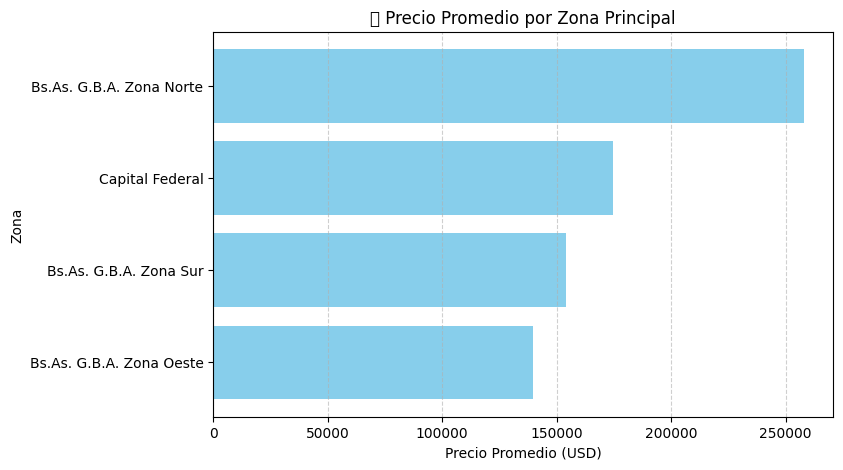

c:\Users\Usuario\Desktop\datos Vivos\TP7\tp\datosvivos\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 127942 (\N{TROPHY}) missing from font(s) DejaVu Sans.



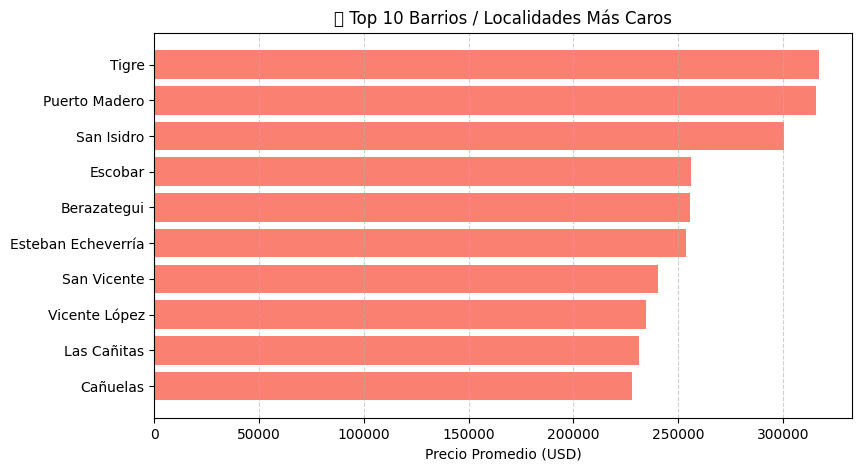

c:\Users\Usuario\Desktop\datos Vivos\TP7\tp\datosvivos\lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 127960 (\N{HOUSE BUILDINGS}) missing from font(s) DejaVu Sans.



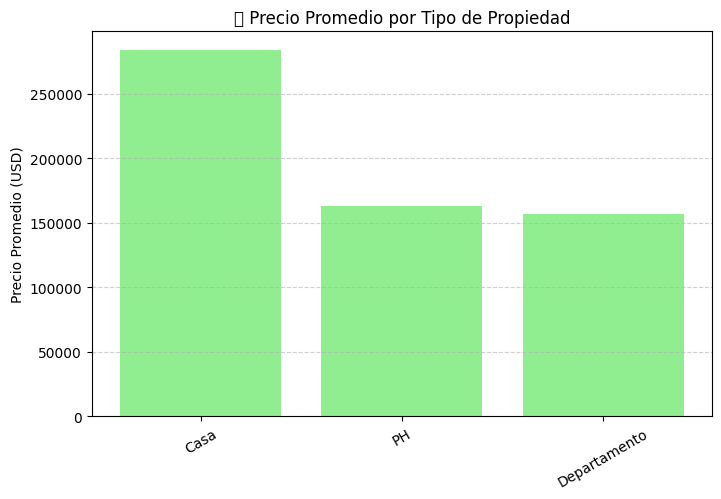

In [132]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# ----------------------------------------------------------
# 1️⃣ INFORMACIÓN GENERAL DEL DATAFRAME
# ----------------------------------------------------------
print("🏠 CONCLUSIONES DE NEGOCIO - PROPIEDADES EN VENTA")
print("=" * 70)

print(f"\nTotal de registros analizados: {len(df6_clean):,}")
print(f"Columnas disponibles: {list(df6_clean.columns)}\n")

# Variables numéricas y categóricas
num_vars = df6_clean.select_dtypes(include=np.number).columns.tolist()
cat_vars = df6_clean.select_dtypes(exclude=np.number).columns.tolist()
print(f"Variables numéricas: {num_vars}")
print(f"Variables categóricas: {cat_vars}\n")

# ----------------------------------------------------------
# 2️⃣ PRECIO PROMEDIO POR ZONA PRINCIPAL
# ----------------------------------------------------------
precio_por_zona = df6_clean.groupby('state_name')['price'].agg(['mean', 'count']).round(0)
precio_por_zona = precio_por_zona.sort_values('mean', ascending=False)

print("\n💰 PRECIO PROMEDIO POR ZONA PRINCIPAL:")
for zona, (precio, cantidad) in precio_por_zona.iterrows():
    print(f"📍 {zona}: USD {precio:,.0f} | {cantidad:,} propiedades")

# ----------------------------------------------------------
# 3️⃣ COMPARACIÓN ENTRE CABA Y GBA
# ----------------------------------------------------------
print("\n🏙️ COMPARACIÓN CABA vs GBA:")

zonas = {
    "CABA": df6_clean[df6_clean['state_name'] == 'Capital Federal'],
    "GBA Norte": df6_clean[df6_clean['state_name'] == 'Bs.As. G.B.A. Zona Norte'],
    "GBA Oeste": df6_clean[df6_clean['state_name'] == 'Bs.As. G.B.A. Zona Oeste'],
    "GBA Sur": df6_clean[df6_clean['state_name'] == 'Bs.As. G.B.A. Zona Sur']
}

for nombre, zona_df in zonas.items():
    if len(zona_df) > 0:
        print(f"{nombre}: {len(zona_df):,} propiedades | Precio promedio: USD {zona_df['price'].mean():,.0f}")
    else:
        print(f"{nombre}: sin datos")

# ----------------------------------------------------------
# 4️⃣ DIFERENCIA ENTRE ZONAS
# ----------------------------------------------------------
zona_mas_cara = precio_por_zona.index[0]
zona_mas_barata = precio_por_zona.index[-1]
diferencia = precio_por_zona['mean'].iloc[0] - precio_por_zona['mean'].iloc[-1]
diferencia_porcentual = (diferencia / precio_por_zona['mean'].iloc[-1]) * 100

print(f"\n📊 BRECHA DE PRECIOS:")
print(f"📍 {zona_mas_cara} es {diferencia_porcentual:.0f}% más caro que {zona_mas_barata}")

# ----------------------------------------------------------
# 5️⃣ BARRIOS MÁS CAROS POR ZONA
# ----------------------------------------------------------
print("\n🏆 BARRIOS O LOCALIDADES MÁS CAROS POR ZONA:")

barrios_top = []
for zona in precio_por_zona.index:
    zona_data = df6_clean[df6_clean['state_name'] == zona]
    barrios_caros = zona_data.groupby('place_name')['price'].mean().sort_values(ascending=False).head(3)
    barrios_top.append(barrios_caros)
    print(f"\n📍 {zona}:")
    for barrio, precio in barrios_caros.items():
        print(f"   • {barrio}: USD {precio:,.0f}")

# ----------------------------------------------------------
# 6️⃣ TIPOS DE PROPIEDAD POR ZONA
# ----------------------------------------------------------
print("\n🏘️ TIPOS DE PROPIEDAD MÁS COMUNES POR ZONA:")
for zona in precio_por_zona.index:
    zona_data = df6_clean[df6_clean['state_name'] == zona]
    tipo_mas_comun = zona_data['property_type'].value_counts().head(2)

    print(f"\n📍 {zona}:")
    for tipo, count in tipo_mas_comun.items():
        porcentaje = (count / len(zona_data)) * 100
        print(f"   • {tipo}: {count} propiedades ({porcentaje:.1f}%)")

# ----------------------------------------------------------
# 7️⃣ CARACTERÍSTICAS PROMEDIO
# ----------------------------------------------------------
print("\n📊 CARACTERÍSTICAS PROMEDIO:")
print(f"• Ambientes: {df6_clean['rooms'].mean():.1f}")
print(f"• Dormitorios: {df6_clean['bedrooms'].mean():.1f}")
print(f"• Baños: {df6_clean['bathrooms'].mean():.1f}")
print(f"• Superficie cubierta: {df6_clean['surface_covered'].mean():.0f} m²")
print(f"• Superficie total: {df6_clean['surface_total'].mean():.0f} m²")

# ----------------------------------------------------------
# 8️⃣ STORYTELLING Y CONCLUSIONES DE NEGOCIO
# ----------------------------------------------------------
print("\n🧠 STORYTELLING - INSIGHTS DE NEGOCIO")
print("-" * 70)

precio_prom = df6_clean['price'].mean()
tipo_frecuente = df6_clean['property_type'].mode()[0]
top_zona = precio_por_zona.index[0]

print(f"""
El mercado inmobiliario analizado (N={len(df6_clean):,}) muestra una fuerte concentración de 
propiedades tipo **{tipo_frecuente}**, reflejando el perfil residencial del área metropolitana.  

💸 **Precio promedio general:** USD {precio_prom:,.0f}  
🏙️ **Zona más cara:** {top_zona}  
🏘️ **Zona más económica:** {zona_mas_barata} ({diferencia_porcentual:.0f}% más barata)

La brecha entre zonas sugiere un mercado segmentado: CABA y GBA Norte concentran la demanda de alto poder adquisitivo,
mientras que GBA Sur y Oeste ofrecen oportunidades de inversión a menor costo.  

A nivel micro, los barrios con mayor valor promedio se destacan como focos de inversión premium, 
mientras que las zonas con alta oferta de departamentos y casas más accesibles mantienen un flujo de operaciones constante.

👉 En síntesis: la **ubicación** y la **superficie** siguen siendo los principales drivers del precio,
pero el **tipo de propiedad y la densidad de oferta local** determinan el atractivo de cada zona.
""")

# ----------------------------------------------------------
# 9️⃣ VISUALIZACIONES
# ----------------------------------------------------------

# --- Gráfico 1: Precio promedio por zona ---
plt.figure(figsize=(8,5))
plt.barh(precio_por_zona.index, precio_por_zona['mean'], color='skyblue')
plt.title("💰 Precio Promedio por Zona Principal")
plt.xlabel("Precio Promedio (USD)")
plt.ylabel("Zona")
plt.gca().invert_yaxis()
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.show()

# --- Gráfico 2: Top 10 barrios más caros ---
top_barrios = df6_clean.groupby('place_name')['price'].mean().sort_values(ascending=False).head(10)
plt.figure(figsize=(9,5))
plt.barh(top_barrios.index[::-1], top_barrios.values[::-1], color='salmon')
plt.title("🏆 Top 10 Barrios / Localidades Más Caros")
plt.xlabel("Precio Promedio (USD)")
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.show()

# --- Gráfico 3: Distribución de precios por tipo de propiedad ---
precio_tipo = df6_clean.groupby('property_type')['price'].mean().sort_values(ascending=False)
plt.figure(figsize=(8,5))
plt.bar(precio_tipo.index, precio_tipo.values, color='lightgreen')
plt.title("🏘️ Precio Promedio por Tipo de Propiedad")
plt.ylabel("Precio Promedio (USD)")
plt.xticks(rotation=30)
plt.grid(axis='y', linestyle='--', alpha=0.6)
plt.show()



In [130]:
import pandas as pd
import numpy as np

# ----------------------------------------------------------
# 1️⃣ INFORMACIÓN GENERAL DEL DATAFRAME
# ----------------------------------------------------------
print("🏠 CONCLUSIONES DE NEGOCIO - PROPIEDADES EN VENTA")
print("=" * 70)

print(f"\nTotal de registros analizados: {len(df6_clean):,}")
print(f"Columnas disponibles: {list(df6_clean.columns)}\n")

# Variables numéricas y categóricas
num_vars = df6_clean.select_dtypes(include=np.number).columns.tolist()
cat_vars = df6_clean.select_dtypes(exclude=np.number).columns.tolist()
print(f"Variables numéricas: {num_vars}")
print(f"Variables categóricas: {cat_vars}\n")

# ----------------------------------------------------------
# 2️⃣ PRECIO PROMEDIO POR ZONA PRINCIPAL
# ----------------------------------------------------------
print("\n💰 PRECIO PROMEDIO POR ZONA PRINCIPAL:")
precio_por_zona = df6_clean.groupby('state_name')['price'].agg(['mean', 'count']).round(0)
precio_por_zona = precio_por_zona.sort_values('mean', ascending=False)

for zona, (precio, cantidad) in precio_por_zona.iterrows():
    print(f"📍 {zona}: USD {precio:,.0f} | {cantidad:,} propiedades")

# ----------------------------------------------------------
# 3️⃣ COMPARACIÓN ENTRE CABA Y GBA
# ----------------------------------------------------------
print("\n🏙️ COMPARACIÓN CABA vs GBA:")

caba = df6_clean[df6_clean['state_name'] == 'Capital Federal']
gba_norte = df6_clean[df6_clean['state_name'] == 'Bs.As. G.B.A. Zona Norte']
gba_sur = df6_clean[df6_clean['state_name'] == 'Bs.As. G.B.A. Zona Sur']
gba_oeste = df6_clean[df6_clean['state_name'] == 'Bs.As. G.B.A. Zona Oeste']

def resumen_zona(nombre, df):
    if len(df) > 0:
        print(f"{nombre}: {len(df):,} propiedades | Precio promedio: USD {df['price'].mean():,.0f}")
    else:
        print(f"{nombre}: sin datos")

resumen_zona("CABA", caba)
resumen_zona("GBA Norte", gba_norte)
resumen_zona("GBA Oeste", gba_oeste)
resumen_zona("GBA Sur", gba_sur)

# ----------------------------------------------------------
# 4️⃣ DIFERENCIA ENTRE ZONA MÁS CARA Y MÁS BARATA
# ----------------------------------------------------------
zona_mas_cara = precio_por_zona.index[0]
zona_mas_barata = precio_por_zona.index[-1]
diferencia = precio_por_zona['mean'].iloc[0] - precio_por_zona['mean'].iloc[-1]
diferencia_porcentual = (diferencia / precio_por_zona['mean'].iloc[-1]) * 100

print(f"\n📊 BRECHA DE PRECIOS ENTRE ZONAS:")
print(f"📍 {zona_mas_cara} es {diferencia_porcentual:.0f}% más caro que {zona_mas_barata}")

# ----------------------------------------------------------
# 5️⃣ BARRIOS / LOCALIDADES MÁS CAROS POR ZONA
# ----------------------------------------------------------
print("\n🏆 BARRIOS O LOCALIDADES MÁS CAROS POR ZONA:")

for zona in precio_por_zona.index:
    zona_data = df6_clean[df6_clean['state_name'] == zona]
    barrios_caros = zona_data.groupby('place_name')['price'].mean().sort_values(ascending=False).head(3)

    print(f"\n📍 {zona}:")
    for barrio, precio in barrios_caros.items():
        print(f"   • {barrio}: USD {precio:,.0f}")

# ----------------------------------------------------------
# 6️⃣ TIPOS DE PROPIEDAD MÁS COMUNES POR ZONA
# ----------------------------------------------------------
print("\n🏘️ TIPOS DE PROPIEDAD MÁS COMUNES POR ZONA:")

for zona in precio_por_zona.index:
    zona_data = df6_clean[df6_clean['state_name'] == zona]
    tipo_mas_comun = zona_data['property_type'].value_counts().head(2)

    print(f"\n📍 {zona}:")
    for tipo, count in tipo_mas_comun.items():
        porcentaje = (count / len(zona_data)) * 100
        print(f"   • {tipo}: {count} propiedades ({porcentaje:.1f}%)")

# ----------------------------------------------------------
# 7️⃣ CARACTERÍSTICAS PROMEDIO
# ----------------------------------------------------------
print("\n📊 CARACTERÍSTICAS PROMEDIO DE LAS PROPIEDADES:")

print(f"• Ambientes: {df6_clean['rooms'].mean():.1f}")
print(f"• Dormitorios: {df6_clean['bedrooms'].mean():.1f}")
print(f"• Baños: {df6_clean['bathrooms'].mean():.1f}")
print(f"• Superficie cubierta: {df6_clean['surface_covered'].mean():.0f} m²")
print(f"• Superficie total: {df6_clean['surface_total'].mean():.0f} m²")

# ----------------------------------------------------------
# 8️⃣ STORYTELLING Y CONCLUSIONES DE NEGOCIO
# ----------------------------------------------------------
print("\n🧠 STORYTELLING - INSIGHTS DE NEGOCIO")
print("-" * 70)

precio_prom = df6_clean['price'].mean()
tipo_frecuente = df6_clean['property_type'].mode()[0]
top_zona = precio_por_zona.index[0]

print(f"""
El análisis de {len(df6_clean):,} propiedades revela un mercado dominado por **{tipo_frecuente}**, 
lo que demuestra la fuerte presencia de propiedades residenciales estándar.

💸 **Precio promedio general:** USD {precio_prom:,.0f}
🏙️ **Zona más cara:** {top_zona}, donde los precios superan ampliamente el promedio general.
🏘️ **Zona más económica:** {zona_mas_barata}, con precios hasta {diferencia_porcentual:.0f}% inferiores.

El contraste entre {zona_mas_cara} y {zona_mas_barata} refleja una **alta segmentación del mercado**, 
donde ubicación y superficie son los principales drivers de valor.

Además, se observa que:
- Las propiedades con mayor cantidad de ambientes y baños tienden a tener precios significativamente más altos.
- Las zonas norte y central (CABA y GBA Norte) concentran la demanda de segmentos de mayor poder adquisitivo.
- En cambio, las zonas sur y oeste presentan oportunidades de inversión con precios más accesibles 
  y potencial de revalorización futura.

En conclusión, **la ubicación geográfica y el tipo de propiedad** son las variables más determinantes 
en la formación del precio, mientras que la superficie y la cantidad de ambientes refuerzan el valor percibido.
""")



🏠 CONCLUSIONES DE NEGOCIO - PROPIEDADES EN VENTA

Total de registros analizados: 150,699
Columnas disponibles: ['state_name', 'place_name', 'rooms', 'bedrooms', 'bathrooms', 'surface_total', 'surface_covered', 'property_type', 'price']

Variables numéricas: ['rooms', 'bedrooms', 'bathrooms', 'surface_total', 'surface_covered', 'price']
Variables categóricas: ['state_name', 'place_name', 'property_type']


💰 PRECIO PROMEDIO POR ZONA PRINCIPAL:
📍 Bs.As. G.B.A. Zona Norte: USD 257,808 | 41,471.0 propiedades
📍 Capital Federal: USD 174,408 | 78,576.0 propiedades
📍 Bs.As. G.B.A. Zona Sur: USD 153,845 | 15,581.0 propiedades
📍 Bs.As. G.B.A. Zona Oeste: USD 139,806 | 15,071.0 propiedades

🏙️ COMPARACIÓN CABA vs GBA:
CABA: 78,576 propiedades | Precio promedio: USD 174,408
GBA Norte: 41,471 propiedades | Precio promedio: USD 257,808
GBA Oeste: 15,071 propiedades | Precio promedio: USD 139,806
GBA Sur: 15,581 propiedades | Precio promedio: USD 153,845

📊 BRECHA DE PRECIOS ENTRE ZONAS:
📍 Bs.As. G.B